![covid](https://www.samsoncontrols.com/sites/default/files/styles/samson_780/public/field/image/covid_19_banner.jpg?itok=itH2AbSL)




<font color='E1672D'> 
## **IST 718 FINAL PROJECT** </font> 

<font color='E1672D'> 
#### THE COVID REPORT 
<br/>

<font color='E1672D'> 
## **GROUP MEMBERS:** </font> 

* Fayick Suleman
* Ingrid Fitzgerald
* Jaqueline Luna 
* Meng Synn
<br>
<br>
<br>
<br>










#INTRODUCTION

<br>

**WHAT IS CORONAVIRUS?**

<p>
Coronavirus is the name given to a group of RNA-related viruses such as SARS-CoV-2, MERS-CoV, HCoV-OC43, etc. 
The coronavirus earned it's name due to the crown-like shape of the viruses under a microscope.
There are 7 strains of the coronavirus group with 3 producing severe symptoms.
The newly identified coronavirus that has caused global pandemic is the SARS-CoV-2.
COVID-19 is the common name given to the disease caused by coronavirus where CO stands for corona, VI stands for virus, D stands for disease, and 19 for the year 2019.

<br>

<br>

**CORONAVIRUS PANDEMIC**

<p>
The Coronavirus Pandemic started in Wuhan, China with first known case traced back in November 2019. The first case of coronavirus in the United States was reported on January 20, 2020 in Washington State.  As of June 9, 2020, there are 7,271,462 cases, 411,593 deaths with 3,581,077 recoveries worldwide.  There are 83,043 cases, 4,634 deaths and 78,351 recoveries recorded in China and 2,038,033 cases, 113,835 deaths and 776,008 recoveries recorded in the US. New York became the epicenter of the virus with 400,099 cases, 30,579 deaths and 84,982 recoveries.



## GUIDING QUESTIONS

The goal of this project is to take county health indicator and use them to rank each county based on their risk for having COVID prevalent in their community. This risk ranking could help a county prioritize things such as making county wide preparations for pandemics or being prioritized for acquiring resources from the federal government.
Our primary guiding question is 'How might counties be assigned risk index numbers to help prioritize and allocate resources?'. In order to answer this questions, several smaller questions needed to be addressed. The first two questions 'What correlations exist between COVID confirmed cases and county health indicators?' and 'What correlations exist between COVID deaths and county health indicators?' seek to first discover any possible correlation between the data.  Next, the question 'Which indicators are significant in modeling COVID cases and deaths?' will allow a more in depth look at the correlated factors and how they might be used for modeling.  Finally, the question 'Can clustering of the most significant factors be used to create risk indicators for counties?' will help create a final map of the risk levels for US counties.





**County Health Measure Data:**
<p>
The foundation of this analysis came from an 8-year long study by the County Health Rankings and Roadmaps program which compiled data from multiple scientific and government reports around a set of health indicators. The county health rankings were compiled in 2018 and do not include any coronavirus Data.  The variety of ranking data are helpful in providing local context on factors that impact health.  The County Health Rankings & Roadmaps program provides data, evidence, guidance, and examples to build awareness of the multiple factors that influence health in order to support community leaders to improve health and increase health equity.

<p>
This analysis looked closely at 61 county health indicators for nearly 3,000 counties. The indicators were divided into five categories.  The categories and example factors can be seen in the list below.


**Types of indicators** (with examples):
* Health Outcomes
 * Frequent mental distress – percentage of population in mental distress for 14 or more days per month
* Health Behaviors
 * Adult Obesity – percentage of the adult population in the county with a BMI of 30 or higher
* Clinical Care
 * Uninsured Adults – Percentage of adults in the county without health insurance
* Social and Economic Factors
 * Some College – percentage of adults ages 18-44 in the county with some post-secondary education.
* Demographics
 * % below 18 - Percentage of the county population under 18


**COVID Data:**
<p>
In addition to the county health indicators, County Level COVID data was also used.  The COVID data includes a daily count of confirmed cases and deaths by county.  The data begins February 1, 2020 and ends as of May 20, 2020.




In [1]:
# from google.colab import drive
# drive.mount("/content/drive", force_remount=True)

# # **************************  Make sure to change path value before running the codes ********************

# #DataDirectory = '/content/drive/My Drive/data/' # MENG

# DataDirectory = 'data/' # INGRID

# # ========================================================================================================

In [3]:
from google.colab import drive
drive.mount('/content/drive')

In [2]:
# %%capture
# !pip install ipython
# !pip install pandasql
# !pip install plotly-geo
# !pip install geopandas==0.3.0
# !pip install pyshp==1.2.10
# !pip install shapely==1.6.3
# !pip install KMeans
# !pip install sklearn
# !pip install nbconvert

In [ ]:
#%reset -f
import os
from pandas import Series
import pandasql
from sklearn.metrics import mean_squared_error
from math import sqrt
from pandas import DataFrame
import pandas as pd  # data frame operations
import numpy as np  # arrays and math functions
from sklearn import linear_model
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from scipy.stats import uniform  # for training-and-test split
import statsmodels.api as sm  # statistical models (including regression)
import statsmodels.formula.api as smf  # R-like model specification
import matplotlib.pyplot as plt  # 2D plotting
import seaborn as sns  # PROVIDES TRELLIS AND SMALL MULTIPLE PLOTTING
sns.set(color_codes=True)
from pandas import read_csv
import matplotlib as mpl
from matplotlib import pyplot
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True) 
import plotly.offline as py
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import plot_roc_curve
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report
import plotly.graph_objects as go
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot

In [ ]:
from sklearn import linear_model
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from scipy.stats import uniform  # for training-and-test split
import statsmodels.api as sm  # statistical models (including regression)
import statsmodels.formula.api as smf  # R-like model specification
import matplotlib.pyplot as plt  # 2D plotting
import seaborn as sns  # PROVIDES TRELLIS AND SMALL MULTIPLE PLOTTING
sns.set(color_codes=True)
import random
random.seed(123)

#OBTAIN, SCRUB, AND EXPLORE

## OBTAIN 

As part of the approach of turning data into information, the **OSEMiN** framework structure was used for this data science project.

The first step was to obtain the data. Three primary data sets were utilized: 
* COVID Confirmed Cases & Death Rate by County
* County Health Rankings - Overall
* County Health Rankings - Detail

## SCRUB
Next, the scrub step included renaming columns, data merging, and handling missing data.



In [ ]:
# This funtion takes the file and checks & processes
def LoadFile(dataFileName):
    isExisted = os.path.isfile(dataFileName)
    if isExisted == True: # Read in the data when the file does exist
        df = pd.read_csv(dataFileName, encoding = 'latin-1')
    else: # Print our message when the file provide does not exist
        print("File name:", dataFileName, "does not exist in", os.getcwd(), "folder")
    return pd.DataFrame(df)

In [ ]:
#Load files by using LoadFile function defines above
states_by_county_death = LoadFile(DataDirectory + "COVID-19_Death_Counts_in_the_United_States_by_County.csv")
state = LoadFile(DataDirectory + "State.csv")
us_counties_cases_deaths = LoadFile(DataDirectory + "us_counties_cases_deaths.csv")
detail_2018_county_health_rankings = LoadFile(DataDirectory + "detail_2018_county_health_rankings.csv")
overall_2018_county_health_ranking = LoadFile(DataDirectory + "overall_2018_county_health_ranking.csv")
MetropolitanPopulation = LoadFile(DataDirectory + "Population_Density_By_County.csv")

In [ ]:
us_counties_cases_deaths.columns[us_counties_cases_deaths.isna().any()].tolist()

['fips']

In [ ]:
overall_2018_county_health_ranking.columns[overall_2018_county_health_ranking.isna().any()].tolist()

[]

In [ ]:
detail_2018_county_health_rankings.columns[detail_2018_county_health_rankings.isna().any()].tolist()

['Number_Adult_Deaths',
 'Age_Adjusted_Mortality',
 'Age_Adjusted_Mortality_Black',
 'Age_Adjusted_Mortality_Hispanic',
 'Age_Adjusted_Mortality_White',
 'Number_Child_Deaths',
 'Child_Mortality_Rate',
 'Child_Mortality_Rate_Black',
 'Child_Mortality_Rate_Hispanic',
 'Child_Mortality_Rate_White',
 'Number_Infant_Deaths',
 'Infant Mortality Rate',
 'Infant_Mortality_Rate_Black',
 'Infant_Mortality_Rate_Hispanic',
 'Infant_Mortality_Rate_White',
 'HIV_Prevalence_Rate',
 'Percent_Limited_Access',
 'Drug_Overdose_Mortality_Rate',
 'Range Drug Overdose Mortality Rate',
 'Motor_Vehicle_Mortality_Rate',
 'Percent_Uninsured_Adults',
 'Percent_Uninsured_Children',
 'Heath_Care_Costs',
 'PCP_Rate',
 'PCP_Ratio',
 'Percent_Disconnected_Youth',
 'Household_Income',
 'Household_ income_Black',
 'Household_ income_Hispanic',
 'Household_ income_White',
 'Percent_Free_Reduced_Lunch',
 'Segregation_Index_Black_White',
 'Segregation_Index_Nonwhite_White',
 'Homicide_Rate',
 'Firearm_Fatalities_Rate',
 

In [ ]:
detail_2018_county_health_rankings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3142 entries, 0 to 3141
Data columns (total 56 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   FIPS                                3142 non-null   int64  
 1   State                               3142 non-null   object 
 2   County                              3142 non-null   object 
 3   Number_Adult_Deaths                 3077 non-null   float64
 4   Age_Adjusted_Mortality              3077 non-null   float64
 5   Age_Adjusted_Mortality_Black        1334 non-null   float64
 6   Age_Adjusted_Mortality_Hispanic     797 non-null    float64
 7   Age_Adjusted_Mortality_White        1556 non-null   float64
 8   Number_Child_Deaths                 1931 non-null   float64
 9   Child_Mortality_Rate                1931 non-null   float64
 10  Child_Mortality_Rate_Black          498 non-null    float64
 11  Child_Mortality_Rate_Hispanic       359 non

In [ ]:
detail_2018_county_health_rankings = detail_2018_county_health_rankings.drop(columns=['PCP_Ratio'], axis = 1)
detail_2018_county_health_rankings = detail_2018_county_health_rankings.drop(columns=['Unnamed: 55'], axis = 1)

In [ ]:
detail_2018_county_health_rankings = detail_2018_county_health_rankings.sort_values(by=['State', 'County'])
for column in detail_2018_county_health_rankings.columns[3:]:
    averageValue = detail_2018_county_health_rankings.groupby(['State','County'])[column].transform('median')
    detail_2018_county_health_rankings[column].fillna(averageValue , inplace=True)

In [ ]:
detail_2018_county_health_rankings = detail_2018_county_health_rankings.ffill().bfill()

In [ ]:
detail_2018_county_health_rankings.head()

,FIPS,State,County,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,1001,Alabama,Autauga,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13,13,12,226.0,14,12.0,10.0,5.0,20.0,36,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,1003,Alabama,Baldwin,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13,13,11,164.0,13,5.0,18.0,10.0,15.0,33,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,1005,Alabama,Barbour,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16,15,18,436.0,23,11.0,18.0,4.0,19.0,39,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,1007,Alabama,Bibb,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13,13,15,192.0,16,3.0,22.0,8.0,27.0,38,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,1009,Alabama,Blount,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14,14,14,95.0,11,3.0,21.0,8.0,23.0,36,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [ ]:
states_by_county_death.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 461 entries, 0 to 460
Data columns (total 8 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   Date as of                 461 non-null    object
 1   First week                 461 non-null    object
 2   Last week                  461 non-null    object
 3   State                      461 non-null    object
 4   County name                461 non-null    object
 5   FIPS County Code           461 non-null    int64 
 6   Deaths involving COVID-19  461 non-null    int64 
 7   Deaths from All Causes     461 non-null    int64 
dtypes: int64(3), object(5)
memory usage: 28.9+ KB


In [ ]:
states_by_county_death.head()

,Date as of,First week,Last week,State,County name,FIPS County Code,Deaths involving COVID-19,Deaths from All Causes
0,5/20/2020,2/1/2020,5/16/2020,AL,Etowah County,1055,11,432
1,5/20/2020,2/1/2020,5/16/2020,AL,Houston County,1069,24,542
2,5/20/2020,2/1/2020,5/16/2020,AL,Jefferson County,1073,79,2675
3,5/20/2020,2/1/2020,5/16/2020,AL,Lee County,1081,43,362
4,5/20/2020,2/1/2020,5/16/2020,AL,Madison County,1089,10,1149


In [ ]:
for column in states_by_county_death.columns:
    states_by_county_death.rename(columns={column: column.replace(' ', '_')}, inplace=True)
states_by_county_death.rename(columns={'County_name': 'County_Name'}, inplace=True)

In [ ]:
states_by_county_death['County_Name'] = states_by_county_death['County_Name'].str.replace(' County', '')

In [ ]:
MetropolitanPopulation['County_Name'] = MetropolitanPopulation['County_Name'].str.replace(' County', '')

In [ ]:
states_by_county_death.head()

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
0,5/20/2020,2/1/2020,5/16/2020,AL,Etowah,1055,11,432
1,5/20/2020,2/1/2020,5/16/2020,AL,Houston,1069,24,542
2,5/20/2020,2/1/2020,5/16/2020,AL,Jefferson,1073,79,2675
3,5/20/2020,2/1/2020,5/16/2020,AL,Lee,1081,43,362
4,5/20/2020,2/1/2020,5/16/2020,AL,Madison,1089,10,1149


In [ ]:
states_by_county_death['FIPS_County_Code'] = states_by_county_death['FIPS_County_Code'].astype(str)
states_by_county_death['FIPS_County_Code'] = states_by_county_death['FIPS_County_Code'].str.pad(width=5, side='left', fillchar='0')

In [ ]:
states_by_county_death_agg = pandasql.sqldf("SELECT sc.State State, sc.County_Name, sc.FIPS_County_Code [FIPS_Code], sc.[Deaths_involving_COVID-19] [COVID_Death], sc.Deaths_from_All_Causes [All_Cause_Death] FROM states_by_county_death sc")

In [ ]:
states_by_county_death.head()

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
0,5/20/2020,2/1/2020,5/16/2020,AL,Etowah,01055,11,432
1,5/20/2020,2/1/2020,5/16/2020,AL,Houston,01069,24,542
2,5/20/2020,2/1/2020,5/16/2020,AL,Jefferson,01073,79,2675
3,5/20/2020,2/1/2020,5/16/2020,AL,Lee,01081,43,362
4,5/20/2020,2/1/2020,5/16/2020,AL,Madison,01089,10,1149


In [ ]:
states_by_county_death_agg = pandasql.sqldf("SELECT sc.*, s.StateName State_Name FROM states_by_county_death_agg sc LEFT JOIN state s ON rtrim(sc.State) = rtrim(ltrim(s.State))")

In [ ]:
states_by_county_death[states_by_county_death['County_Name'] == 'Nassau']

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
302,5/20/2020,2/1/2020,5/16/2020,NY,Nassau,36059,2430,6804


In [ ]:
states_by_county_death_agg.head()

,State,County_Name,FIPS_Code,COVID_Death,All_Cause_Death,State_Name
0,AL,Etowah,01055,11,432,Alabama
1,AL,Houston,01069,24,542,Alabama
2,AL,Jefferson,01073,79,2675,Alabama
3,AL,Lee,01081,43,362,Alabama
4,AL,Madison,01089,10,1149,Alabama


In [ ]:
us_counties_cases_deaths.rename(columns={'fips': 'FIPS_Code'}, inplace=True)
us_counties_cases_deaths.rename(columns={'state': 'State_Name'}, inplace=True)
us_counties_cases_deaths.rename(columns={'county': 'County_Name'}, inplace=True)
us_counties_cases_deaths.rename(columns={'date': 'Date_Name'}, inplace=True)

In [ ]:
us_counties_cases_deaths.head()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
0,2020-01-21,Snohomish,Washington,53061.0,1,0
1,2020-01-22,Snohomish,Washington,53061.0,1,0
2,2020-01-23,Snohomish,Washington,53061.0,1,0
3,2020-01-24,Cook,Illinois,17031.0,1,0
4,2020-01-24,Snohomish,Washington,53061.0,1,0


In [ ]:
us_counties_cases_deaths['FIPS_Code'] = us_counties_cases_deaths['FIPS_Code'].astype(str)
us_counties_cases_deaths['FIPS_Code'] = us_counties_cases_deaths['FIPS_Code'].str.replace('.0', '')
us_counties_cases_deaths['FIPS_Code'] =  us_counties_cases_deaths['FIPS_Code'].str.pad(width=5, side='left', fillchar='0')

In [ ]:
us_counties_cases_deaths.head()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
0,2020-01-21,Snohomish,Washington,00561,1,0
1,2020-01-22,Snohomish,Washington,00561,1,0
2,2020-01-23,Snohomish,Washington,00561,1,0
3,2020-01-24,Cook,Illinois,00131,1,0
4,2020-01-24,Snohomish,Washington,00561,1,0


In [ ]:
overall_2018_county_health_ranking.rename(columns={'ï»¿FIPS': 'FIPS_Code'}, inplace=True)
overall_2018_county_health_ranking.rename(columns={'ï»¿FIPS': 'FIPS_Code'}, inplace=True)

In [ ]:
us_counties_cases_deaths_agg = pandasql.sqldf("SELECT s.State, c.State_Name, c.County_Name, c.FIPS_Code, SUM(c.cases) COVID_Confirm, SUM(c.deaths) COVID_Death FROM us_counties_cases_deaths c LEFT JOIN state s ON c.State_Name = s.StateName GROUP BY c.State_Name, c.County_Name, c.FIPS_Code")

In [ ]:
us_counties_cases_deaths_agg.head()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
0,AL,Alabama,Autauga,00001,2717,123
1,AL,Alabama,Baldwin,00003,7949,197
2,AL,Alabama,Barbour,00005,1981,24
3,AL,Alabama,Bibb,00007,1689,15
4,AL,Alabama,Blount,00009,1590,6


In [ ]:
us_counties_cases_deaths.tail()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
167834,2020-05-22,Sublette,Wyoming,00535,3,0
167835,2020-05-22,Sweetwater,Wyoming,00537,25,0
167836,2020-05-22,Teton,Wyoming,00539,100,1
167837,2020-05-22,Uinta,Wyoming,00541,13,0
167838,2020-05-22,Washakie,Wyoming,00543,19,1


In [ ]:
us_counties_cases_deaths.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 167839 entries, 0 to 167838
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Date_Name    167839 non-null  object
 1   County_Name  167839 non-null  object
 2   State_Name   167839 non-null  object
 3   FIPS_Code    167839 non-null  object
 4   cases        167839 non-null  int64 
 5   deaths       167839 non-null  int64 
dtypes: int64(2), object(4)
memory usage: 7.7+ MB


In [ ]:
COVID_19_522 = pandasql.sqldf("SELECT s.State, c.State_Name, c.County_Name, c.FIPS_Code, c.cases COVID_Confirm, c.deaths COVID_Death FROM us_counties_cases_deaths c JOIN state s ON c.State_Name = s.StateName WHERE Date_Name = '2020-05-22' AND c.County_Name <> 'Unknown'")

In [ ]:
COVID_19_522.head()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
0,AL,Alabama,Autauga,00001,149,3
1,AL,Alabama,Baldwin,00003,271,9
2,AL,Alabama,Barbour,00005,104,1
3,AL,Alabama,Bibb,00007,55,1
4,AL,Alabama,Blount,00009,49,1


In [ ]:
#pandasql.sqldf("SELECT DISTINCT State, State_Name FROM COVID_19")

In [ ]:
us_counties_cases_deaths.rename(columns={'date': 'Date_Name'}, inplace=True)

In [ ]:
us_counties_cases_deaths.head()

,Date_Name,County_Name,State_Name,FIPS_Code,cases,deaths
0,2020-01-21,Snohomish,Washington,00561,1,0
1,2020-01-22,Snohomish,Washington,00561,1,0
2,2020-01-23,Snohomish,Washington,00561,1,0
3,2020-01-24,Cook,Illinois,00131,1,0
4,2020-01-24,Snohomish,Washington,00561,1,0


In [ ]:
COVID_19_BY_STATE = pandasql.sqldf("SELECT State, SUM(COVID_Confirm) COVID_Confirm, SUM(COVID_Death) COVID_Death FROM COVID_19_522 GROUP BY State")

In [ ]:
COVID_19_BY_STATE.head()

,State,COVID_Confirm,COVID_Death
0,AK,403,8
1,AL,13670,541
2,AR,5468,113
3,AZ,15608,775
4,CA,90801,3690


In [ ]:
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objs as go

def show_plotly_in_colab():
  import IPython
  display(IPython.core.display.HTML('''
  <script src="/static/components/requirejs/require.js"></script>
  <script>
  requirejs.config({
    paths:{
      base:'static/base',
      plotly:'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
    },
    });
    '''))


## EXPLORE MAPS

Next, in the OSEMiN framework is exploring the data. The first map shows the COVID confirmed cases by state. The second map shows the COVID deaths by state. The third map shows all causes of death per state.

In all maps, states like California, Illinois, and New York were among the highest states with confirmed cases or deaths.

Next, the data was explored into a more granular level with county-level maps. The first countly-level map shows the COVID confirm cases where counties in the states of California, New York, Florida, and Illinois are among the highest with confirmed cases. This is followed by counties in the states of Washington, Oregon, and Maine with noticable high numbers of confirmed cases.

The final map of the COVID deaths by county shows that the pattern of the hot spots for COVID deaths follows the same pattern of the  confirmed cases by county map mentioned before.





In [ ]:
show_plotly_in_colab()
init_notebook_mode(connected=False)

data = dict (
    type = 'choropleth',
    locations = COVID_19_BY_STATE['State'],
    locationmode='USA-states',
    colorscale = ['#3f39bd', '#4ae5f0','#4bd673','#c2c43d'],
    colorbar_title = 'Total',
    #text = COVID_19_BY_STATE['FIPS_Code'],
     #showlegend = True,
    z=COVID_19_BY_STATE['COVID_Confirm'])
    
layout = dict(
        title = 'Confirmed Cases',
        geo = dict(scope='usa'))

map = go.Figure(data=[data], layout = layout)
py.iplot(map)

In [ ]:
show_plotly_in_colab()
init_notebook_mode(connected=False)

data = dict (
    type = 'choropleth',
    locations = COVID_19_BY_STATE['State'],
    locationmode='USA-states',
    colorscale=['#32637b','#657e60','#768157','#988745','#fe980e'],
    #colorscale=['#00225b','#1b6fff','#3a81c1','#63996f','#97b708'],
    colorbar_title = 'Total',
     #showlegend = True,
    z=COVID_19_BY_STATE['COVID_Death'])
    
layout = dict(
        title = 'Confirmed COVID Death',
        geo = dict(scope='usa'))

map = go.Figure(data=[data], layout = layout)
py.iplot(map)

In [ ]:
states_by_county_death.head()

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
0,5/20/2020,2/1/2020,5/16/2020,AL,Etowah,01055,11,432
1,5/20/2020,2/1/2020,5/16/2020,AL,Houston,01069,24,542
2,5/20/2020,2/1/2020,5/16/2020,AL,Jefferson,01073,79,2675
3,5/20/2020,2/1/2020,5/16/2020,AL,Lee,01081,43,362
4,5/20/2020,2/1/2020,5/16/2020,AL,Madison,01089,10,1149


In [ ]:
show_plotly_in_colab()
init_notebook_mode(connected=False)

data = dict (
    type = 'choropleth',
    locations = states_by_county_death['State'],
    locationmode='USA-states',
    #colorscale = ['#683648','#6e5556','#737564','#789472','#6bb1b6'],
    colorscale=['#6bb1b6','#737564','#6e5556','#683648'],
    #colorscale=['#0986b9','#1583ad','#2180a2','#2c7d96','#38798b','#44767f','#507374','#5c7068','#686d5c','#746a51','#7f6645','#8b633a','#97602e'],
    colorbar_title = 'Total',
     #text = COVID_19['FIPS_Code'],
     #showlegend = True,
     z=states_by_county_death['Deaths_from_All_Causes'])
    
layout = dict(
        title = 'All Causes of Death',
        geo = dict(scope='usa'))

map = go.Figure(data=[data], layout = layout)
py.iplot(map)

In [ ]:
#overall_2018_county_health_ranking['FIPS_Code'] = overall_2018_county_health_ranking['FIPS_Code'].astype(str)
#overall_2018_county_health_ranking['FIPS_Code'] = overall_2018_county_health_ranking['FIPS_Code'].str.pad(width=5, side='left', fillchar='0')

In [ ]:
df_State_County_Zip = LoadFile(DataDirectory + "FIPS.csv")

In [ ]:
df_State_County_Zip['FIPS_Code'] = df_State_County_Zip['FIPS_Code'].astype(str)
df_State_County_Zip['FIPS_Code'] = df_State_County_Zip['FIPS_Code'].str.pad(width=5, side='left', fillchar='0')

In [ ]:
#state_county_map= pandasql.sqldf("SELECT c.State_Name, c.County_Name, c.COVID_Confirm, c.COVID_Death, z.FIPS_Code FIPS , s.State FROM COVID_19_522_HEALTH_CORRELATION c LEFT JOIN df_State_County_Zip z ON c.State_Name= z.State_Name AND c.County_Name= z.County_Name LEFT JOIN state s ON c.State_Name = s.StateName")

In [ ]:
#state_county_map= pandasql.sqldf("SELECT c.State_Name, c.County_Name, c.COVID_Confirm, c.COVID_Death, z.FIPS_Code FIPS , s.State, f.cluster FROM COVID_19_522_HEALTH_CORRELATION c LEFT JOIN df_State_County_Zip z ON c.State_Name= z.State_Name AND c.County_Name= z.County_Name LEFT JOIN state s ON c.State_Name = s.StateName LEFT JOIN cluster_confirm f ON c.State_Name= f.State_Name")

In [ ]:
#state_county_map2= pandasql.sqldf("SELECT c.State_Name, c.County_Name, c.COVID_Confirm, c.COVID_Death, z.FIPS_Code FIPS , s.State, f.cluster FROM cluster_confirm f LEFT JOIN  COVID_19_522_HEALTH_CORRELATION c ON f.State_Name= c.State_Name AND f.County_Name=c.County_Name LEFT JOIN df_State_County_Zip z ON f.State_Name= z.State_Name AND f.County_Name= z.County_Name  LEFT JOIN state s ON f.State_Name= s.StateName")

In [ ]:
state_county_map= pd.read_csv(DataDirectory + "state_conty.csv")
state_county_map2= pd.read_csv(DataDirectory + "state_conty2.csv")

In [ ]:
state_county_map.dropna(inplace=True)
state_county_map2.dropna(inplace=True)

In [ ]:
state_county_map.head()

,Unnamed: 0,State_Name,County_Name,COVID_Confirm,COVID_Death,FIPS,State
0,0,Alabama,Autauga,149,3,1001,AL
1,1,Alabama,Baldwin,271,9,1003,AL
2,2,Alabama,Barbour,104,1,1005,AL
3,3,Alabama,Bibb,55,1,1007,AL
4,4,Alabama,Blount,49,1,1009,AL


In [ ]:
cluster_re_assign=[]

for row in state_county_map2['cluster']:
    if row == 2:
        cluster_re_assign.append('Medium Risk')
    elif row == 1:
        cluster_re_assign.append('High Risk')
    elif row ==0:
        cluster_re_assign.append('Low Risk')
    else:
        cluster_re_assign.append('Not found')

state_county_map2['Clusters']= cluster_re_assign


In [ ]:
state_county_map2.Clusters.unique()


array(['Low Risk', 'Medium Risk', 'High Risk', 'Not found'], dtype=object)

In [ ]:
state_county_map.isna().sum()

Unnamed: 0       0
State_Name       0
County_Name      0
COVID_Confirm    0
COVID_Death      0
FIPS             0
State            0
dtype: int64

In [ ]:
state_county_map['FIPS'] = state_county_map['FIPS'].astype(int)
state_county_map2['FIPS'] = state_county_map2['FIPS'].astype(int)

In [ ]:
state_county_map.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2809 entries, 0 to 2808
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Unnamed: 0     2809 non-null   int64 
 1   State_Name     2809 non-null   object
 2   County_Name    2809 non-null   object
 3   COVID_Confirm  2809 non-null   int64 
 4   COVID_Death    2809 non-null   int64 
 5   FIPS           2809 non-null   int64 
 6   State          2809 non-null   object
dtypes: int64(4), object(3)
memory usage: 175.6+ KB


In [ ]:
state_county_map2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2862 entries, 0 to 2861
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Unnamed: 0     2862 non-null   int64 
 1   State_Name     2862 non-null   object
 2   County_Name    2862 non-null   object
 3   COVID_Confirm  2862 non-null   int64 
 4   COVID_Death    2862 non-null   int64 
 5   FIPS           2862 non-null   int64 
 6   State          2862 non-null   object
 7   cluster        2862 non-null   int64 
 8   Clusters       2862 non-null   object
dtypes: int64(5), object(4)
memory usage: 223.6+ KB


In [ ]:
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objs as go

def show_plotly_in_colab():
  import IPython
  display(IPython.core.display.HTML('''
  <script src="/static/components/requirejs/require.js"></script>
  <script>
  requirejs.config({
    paths:{
      base:'static/base',
      plotly:'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
    },
    });
    '''))


In [ ]:
import plotly.figure_factory as ff
show_plotly_in_colab()
init_notebook_mode(connected=False)

#COVID-19 Confirmed Cases Map
state_county_map['FIPS'] = state_county_map.FIPS 

colorscale=['#09e77c','#3cb98d','#3cb98d','#6f8b9e','#807ca3','#916da9','#a25eae','#b34eb4','#b34eb4','#c43fb9','#c43fb9' ,'#d530bf']

endpts = list(np.linspace(1, 68949, len(colorscale) - 1))
fips = state_county_map['FIPS'].tolist()
values = state_county_map['COVID_Confirm'].tolist()

fig = ff.create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=True,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='COVID-19 Confirm Cases',
    legend_title='Confirm cases'
)

fig.layout.template = None
fig.show()

In [ ]:
#COVID-19 Deaths Map

show_plotly_in_colab()
init_notebook_mode(connected=False)

state_county_map['FIPS'] = state_county_map.FIPS 
colorscale=['#b34eb4','#a25eae','#916da9','#807ca3','#6f8b9e','#3cb98d','#3cb98d','#09e77c','#11d306']

endpts = list(np.linspace(1, 3187, len(colorscale) - 1))
fips = state_county_map['FIPS'].tolist()
values = state_county_map['COVID_Death'].tolist()

fig = ff.create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=True,
    show_hover=True, centroid_marker={'opacity': 1},
    asp=2.9, title='COVID-19 Deaths',
    legend_title='Confirm deaths'
)

fig.layout.template = None
fig.show()

In [ ]:
overall_2018_county_health_ranking.head()

,FIPS_Code,State,County,Length of Life Rank,Quality of Life Rank,Health Behaviors Rank,Clinical Care Rank,Social & Economic Factors Rank,Physical Environment Rank,Health Outcomes Rank,Health Factors Rank
0,1001,Alabama,Autauga,18,5,12,15,3,51,11,8
1,1003,Alabama,Baldwin,4,4,3,7,8,14,3,3
2,1005,Alabama,Barbour,14,49,57,20,58,16,34,56
3,1007,Alabama,Bibb,53,25,39,42,42,29,41,37
4,1009,Alabama,Blount,17,12,11,41,13,54,14,19


In [ ]:
#detail_2018_county_health_rankings.rename(columns={'FIPS': 'FIPS_Code'}, inplace=True)
detail_2018_county_health_rankings.rename(columns={'State': 'State_Name'}, inplace=True)

In [ ]:
#detail_2018_county_health_rankings.info()

In [ ]:
detail_2018_county_health_rankings.head()

,FIPS,State_Name,County,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,1001,Alabama,Autauga,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13,13,12,226.0,14,12.0,10.0,5.0,20.0,36,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,1003,Alabama,Baldwin,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13,13,11,164.0,13,5.0,18.0,10.0,15.0,33,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,1005,Alabama,Barbour,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16,15,18,436.0,23,11.0,18.0,4.0,19.0,39,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,1007,Alabama,Bibb,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13,13,15,192.0,16,3.0,22.0,8.0,27.0,38,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,1009,Alabama,Blount,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14,14,14,95.0,11,3.0,21.0,8.0,23.0,36,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [ ]:
for column in overall_2018_county_health_ranking.columns:
    overall_2018_county_health_ranking.rename(columns={column: column.replace(' ', '_').replace('&_', '')}, inplace=True)
    
overall_2018_county_health_ranking.rename(columns={'State': 'State_Name'}, inplace=True)
overall_2018_county_health_ranking.rename(columns={'County': 'County_Name'}, inplace=True)

In [ ]:
#overall_2018_county_health_ranking.info()

In [ ]:
overall_2018_county_health_ranking.tail()

,FIPS_Code,State_Name,County_Name,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank
3137,56037,Wyoming,Sweetwater,6,18,20,11,20,19,15,21
3138,56039,Wyoming,Teton,1,2,1,1,1,15,1,1
3139,56041,Wyoming,Uinta,18,21,19,6,17,13,21,17
3140,56043,Wyoming,Washakie,5,14,7,22,16,5,8,15
3141,56045,Wyoming,Weston,10,3,17,12,11,9,4,14


In [ ]:
COVID_19_522.tail()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
2927,WY,Wyoming,Sublette,00535,3,0
2928,WY,Wyoming,Sweetwater,00537,25,0
2929,WY,Wyoming,Teton,00539,100,1
2930,WY,Wyoming,Uinta,00541,13,0
2931,WY,Wyoming,Washakie,00543,19,1


In [ ]:
COVID_19_522_OVERALL_HEALTH = pandasql.sqldf("SELECT c.State, c.State_Name, c.County_Name, c.COVID_Confirm, c.COVID_Death, o.Length_of_Life_Rank, o.Quality_of_Life_Rank, o.Health_Behaviors_Rank, o.Clinical_Care_Rank, o.Social_Economic_Factors_Rank, o.Physical_Environment_Rank, o.Health_Outcomes_Rank, o.Health_Factors_Rank FROM COVID_19_522 c LEFT JOIN overall_2018_county_health_ranking o ON c.State_Name = o.State_Name AND c.County_Name = o.County_Name")

In [ ]:
COVID_19_522_OVERALL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank
0,AL,Alabama,Autauga,149,3,18,5,12,15,3,51,11,8
1,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3
2,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56
3,AL,Alabama,Bibb,55,1,53,25,39,42,42,29,41,37
4,AL,Alabama,Blount,49,1,17,12,11,41,13,54,14,19


In [ ]:
COVID_19_522_DETAIL_HEALTH = pandasql.sqldf("SELECT c.State, c.State_Name, c.County_Name, c.COVID_Confirm, c.COVID_Death, o.[Number_Adult_Deaths], o.[Age_Adjusted_Mortality],o.[Age_Adjusted_Mortality_Black],o.[Age_Adjusted_Mortality_Hispanic],o.[Age_Adjusted_Mortality_White],o.[Number_Child_Deaths], o.[Child_Mortality_Rate],o.[Child_Mortality_Rate_Black],o.[Child_Mortality_Rate_Hispanic], o.[Child_Mortality_Rate_White],o.[Number_Infant_Deaths],o.[Infant Mortality Rate],o.[Infant_Mortality_Rate_Black],o.[Infant_Mortality_Rate_Hispanic],o.[Infant_Mortality_Rate_White],o.[Percent_Frequent_Physical_Distress],o.[Percent_Frequent_Mental_Distress],o.[Percent_Diabetic],o.[HIV_Prevalence_Rate],o.[Percent_Food_Insecure],o.[Percent_Limited_Access],o.[Drug_Overdose_Mortality_Rate],o.[Range Drug Overdose Mortality Rate],o.[Motor_Vehicle_Mortality_Rate],o.[Percent_Insufficient_ Sleep],o.[Percent_Uninsured_Adults],o.[Percent_Uninsured_Children],o.[Heath_Care_Costs],o.[PCP_Rate], o.[Percent_Disconnected_Youth],o.[Household_Income],o.[Household_ income_Black],o.[Household_ income_Hispanic],o.[Household_ income_White],o.[Percent_Free_Reduced_Lunch],o.[Segregation_Index_Black_White],o.[Segregation_Index_Nonwhite_White],o.[Homicide_Rate],o.[Firearm_Fatalities_Rate],o.[Population],o.[Percent_Under18],o.[Percent_65_and_over],o.[Percent_African_American],o.[Percent_American_Alaskan_Indian],o.[Percent_Asian],o.[Percent_Hawaiian_PacificIslander],o.[Percent_Hispanic],o.[Percent_White],o.[Percent_ Not_Proficient_English],o.[Percent_Female],o.[Percent_Rural] FROM COVID_19_522 c LEFT JOIN detail_2018_county_health_rankings o ON c.State_Name = o.State_Name AND c.County_Name = o.County")

In [ ]:
COVID_19_522.head()

,State,State_Name,County_Name,FIPS_Code,COVID_Confirm,COVID_Death
0,AL,Alabama,Autauga,00001,149,3
1,AL,Alabama,Baldwin,00003,271,9
2,AL,Alabama,Barbour,00005,104,1
3,AL,Alabama,Bibb,00007,55,1
4,AL,Alabama,Blount,00009,49,1


In [ ]:
detail_2018_county_health_rankings.head()

,FIPS,State_Name,County,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,1001,Alabama,Autauga,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13,13,12,226.0,14,12.0,10.0,5.0,20.0,36,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,1003,Alabama,Baldwin,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13,13,11,164.0,13,5.0,18.0,10.0,15.0,33,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,1005,Alabama,Barbour,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16,15,18,436.0,23,11.0,18.0,4.0,19.0,39,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,1007,Alabama,Bibb,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13,13,15,192.0,16,3.0,22.0,8.0,27.0,38,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,1009,Alabama,Blount,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14,14,14,95.0,11,3.0,21.0,8.0,23.0,36,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [ ]:
COVID_19_522_DETAIL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13.0,13.0,12.0,226.0,14.0,12.0,10.0,5.0,20.0,36.0,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416.0,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13.0,13.0,11.0,164.0,13.0,5.0,18.0,10.0,15.0,33.0,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563.0,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16.0,15.0,18.0,436.0,23.0,11.0,18.0,4.0,19.0,39.0,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965.0,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,AL,Alabama,Bibb,55,1,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13.0,13.0,15.0,192.0,16.0,3.0,22.0,8.0,27.0,38.0,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643.0,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,AL,Alabama,Blount,49,1,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14.0,14.0,14.0,95.0,11.0,3.0,21.0,8.0,23.0,36.0,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704.0,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [ ]:
#COVID_19_522_DETAIL_HEALTH = COVID_19_522_DETAIL_HEALTH.dropna(inplace=True)

In [ ]:
COVID_19_522_DETAIL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13.0,13.0,12.0,226.0,14.0,12.0,10.0,5.0,20.0,36.0,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416.0,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13.0,13.0,11.0,164.0,13.0,5.0,18.0,10.0,15.0,33.0,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563.0,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16.0,15.0,18.0,436.0,23.0,11.0,18.0,4.0,19.0,39.0,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965.0,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,AL,Alabama,Bibb,55,1,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13.0,13.0,15.0,192.0,16.0,3.0,22.0,8.0,27.0,38.0,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643.0,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,AL,Alabama,Blount,49,1,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14.0,14.0,14.0,95.0,11.0,3.0,21.0,8.0,23.0,36.0,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704.0,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


In [ ]:
for column in COVID_19_522_OVERALL_HEALTH.columns:
    COVID_19_522_OVERALL_HEALTH[column] = COVID_19_522_OVERALL_HEALTH[column].astype(str).replace('NR', '0')
    COVID_19_522_OVERALL_HEALTH[column] = COVID_19_522_OVERALL_HEALTH[column].astype(str).replace('None', '0')

In [ ]:
for column in COVID_19_522_OVERALL_HEALTH.columns[3:13]:
    COVID_19_522_OVERALL_HEALTH[column] = pd.to_numeric(COVID_19_522_OVERALL_HEALTH[column])

In [ ]:
COVID_19_522_OVERALL_HEALTH.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2932 entries, 0 to 2931
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   State                         2932 non-null   object
 1   State_Name                    2932 non-null   object
 2   County_Name                   2932 non-null   object
 3   COVID_Confirm                 2932 non-null   int64 
 4   COVID_Death                   2932 non-null   int64 
 5   Length_of_Life_Rank           2932 non-null   int64 
 6   Quality_of_Life_Rank          2932 non-null   int64 
 7   Health_Behaviors_Rank         2932 non-null   int64 
 8   Clinical_Care_Rank            2932 non-null   int64 
 9   Social_Economic_Factors_Rank  2932 non-null   int64 
 10  Physical_Environment_Rank     2932 non-null   int64 
 11  Health_Outcomes_Rank          2932 non-null   int64 
 12  Health_Factors_Rank           2932 non-null   int64 
dtypes: int64(10), obje

## EXPLORE CORRELATION

After exploring the maps, the next step was to begin looking for answers to our first question: Which county health indicators are correlated to COVID Confirmed cases? The pairs plot shows that there are several outliers such as New York in the upper left corner with most of the data falling in near zero. Next, a correlation matrix shows the first two columns, COVID Confirmed and COVID Deaths, are not correlated to any county health indicators.  This prompted further exploration of the data which shows that the histogram is heavily skewed.  



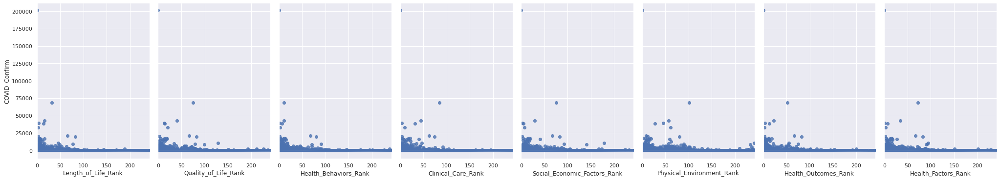

In [ ]:
sns.pairplot(COVID_19_522_OVERALL_HEALTH, x_vars=['Length_of_Life_Rank','Quality_of_Life_Rank', 'Health_Behaviors_Rank', 'Clinical_Care_Rank', 'Social_Economic_Factors_Rank', 'Physical_Environment_Rank', 'Health_Outcomes_Rank', 'Health_Factors_Rank'],  y_vars='COVID_Confirm', height=5, aspect=0.7, kind='reg')

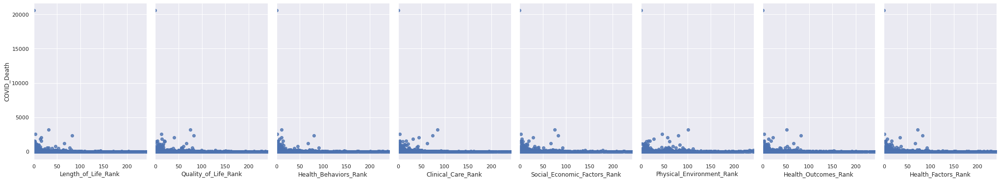

In [ ]:
sns.pairplot(COVID_19_522_OVERALL_HEALTH, x_vars=['Length_of_Life_Rank','Quality_of_Life_Rank', 'Health_Behaviors_Rank', 'Clinical_Care_Rank', 'Social_Economic_Factors_Rank', 'Physical_Environment_Rank', 'Health_Outcomes_Rank', 'Health_Factors_Rank'],  y_vars='COVID_Death', height=5, aspect=0.7, kind='reg')

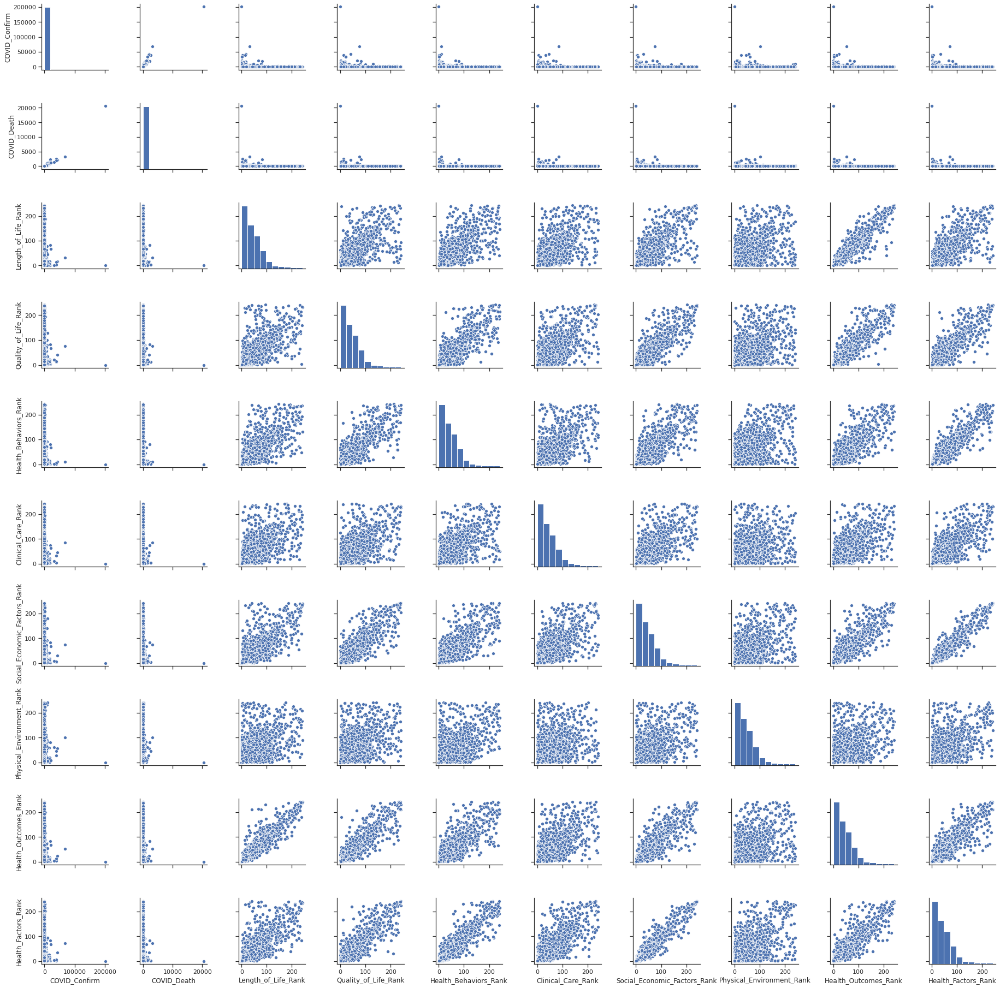

In [ ]:
sns.set(style="ticks", color_codes=True)
pairp=g = sns.pairplot(COVID_19_522_OVERALL_HEALTH)
plt.show()


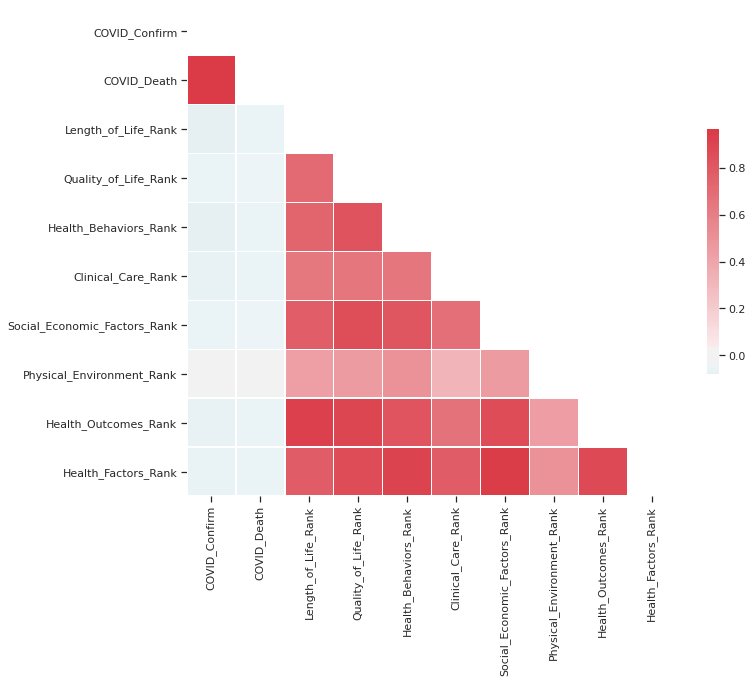

In [ ]:
corr = COVID_19_522_OVERALL_HEALTH.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.show()


In [ ]:
COVID_19_522_OVERALL_HEALTH.tail()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank
2927,WY,Wyoming,Sublette,3,0,2,4,5,9,8,17,2,7
2928,WY,Wyoming,Sweetwater,25,0,6,18,20,11,20,19,15,21
2929,WY,Wyoming,Teton,100,1,1,2,1,1,1,15,1,1
2930,WY,Wyoming,Uinta,13,0,18,21,19,6,17,13,21,17
2931,WY,Wyoming,Washakie,19,1,5,14,7,22,16,5,8,15


In [ ]:
 COVID_19_522_OVERALL_HEALTH_POP = pandasql.sqldf("SELECT c.*, p.DensitySQMile FROM  COVID_19_522_OVERALL_HEALTH c JOIN MetropolitanPopulation p WHERE c.State_Name = c.State_Name AND c.County_Name = p.County_Name")

In [ ]:
COVID_19_522_OVERALL_HEALTH_POP.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank,DensitySQMile
0,AL,Alabama,Autauga,149,3,18,5,12,15,3,51,11,8,91.8
1,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3,114.6
2,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3,177.3
3,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56,31.0
4,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56,48.6


In [ ]:
COVID_19_522_DETAIL_HEALTH_POP = pandasql.sqldf("SELECT c.*, p.DensitySQMile FROM  COVID_19_522_DETAIL_HEALTH c JOIN MetropolitanPopulation p WHERE c.State_Name = c.State_Name AND c.County_Name = p.County_Name")

In [ ]:
COVID_19_522_DETAIL_HEALTH_POP.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural,DensitySQMile
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13.0,13.0,12.0,226.0,14.0,12.0,10.0,5.0,20.0,36.0,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416.0,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0,91.8
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13.0,13.0,11.0,164.0,13.0,5.0,18.0,10.0,15.0,33.0,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563.0,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3,114.6
2,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13.0,13.0,11.0,164.0,13.0,5.0,18.0,10.0,15.0,33.0,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563.0,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3,177.3
3,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16.0,15.0,18.0,436.0,23.0,11.0,18.0,4.0,19.0,39.0,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965.0,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8,31.0
4,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16.0,15.0,18.0,436.0,23.0,11.0,18.0,4.0,19.0,39.0,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965.0,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8,48.6


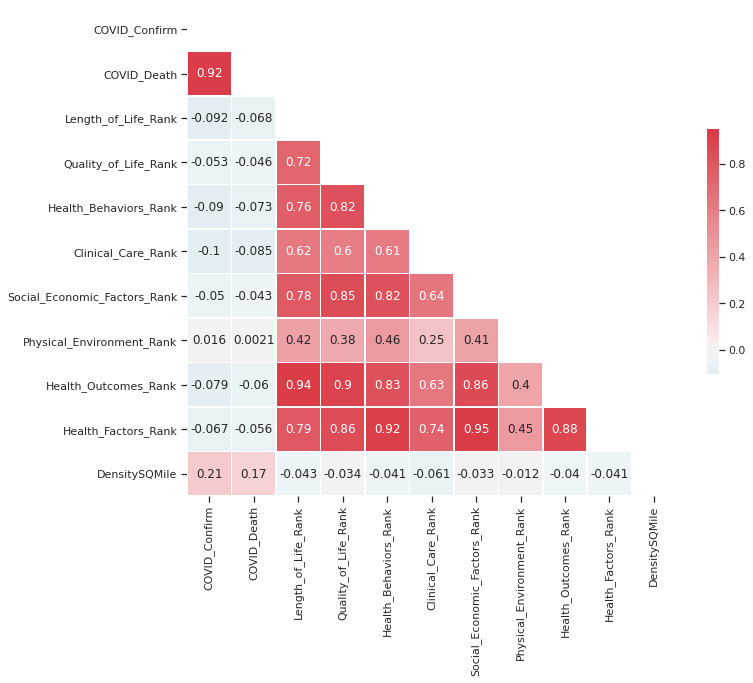

In [ ]:
corr = COVID_19_522_OVERALL_HEALTH_POP.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plt.show()


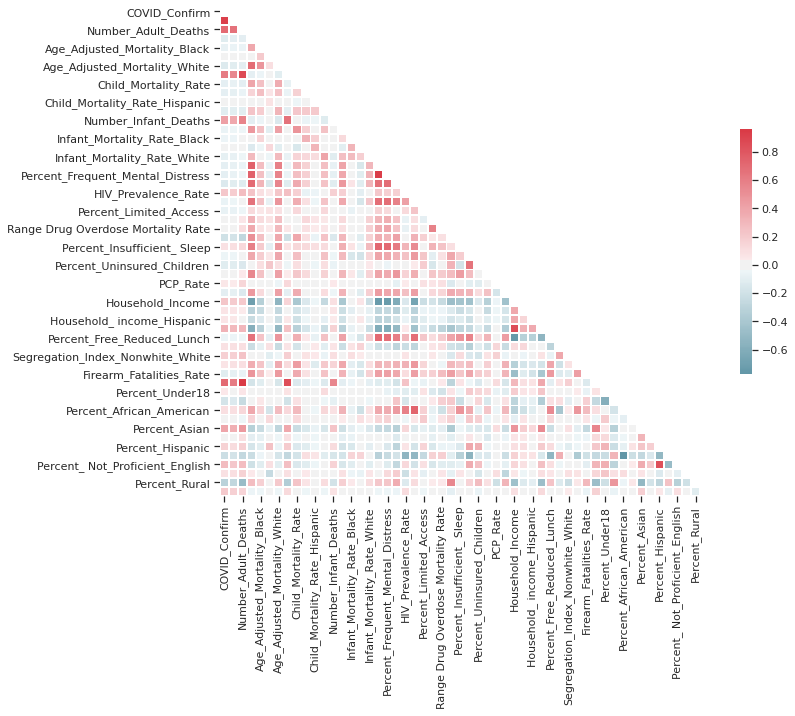

In [ ]:
corr = COVID_19_522_DETAIL_HEALTH_POP.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.9, cbar_kws={"shrink": .5})
plt.show()


In [ ]:
corr_matrix =  COVID_19_522_DETAIL_HEALTH_POP.corr().abs()

#the matrix is symmetric so we need to extract upper triangle matrix without diagonal (k = 1)
sol = (corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
                 .stack()
                 .sort_values(ascending=False))


In [ ]:
#pd.set_option('display.max_rows', None)
#dfsol = DataFrame(sol)
#dfsol.to_csv("/content/drive/My Drive/daat/export.csv")

In [ ]:
#DETAIL_HEALTH_CORRELATION = LoadFile(DataDirectory + "DETAIL_HEALTH_CORRELATION.csv")

In [ ]:
#pd.set_option('display.max_rows', None)
#DETAIL_HEALTH_CORRELATION.head()

In [ ]:
#pandasql.sqldf("SELECT * FROM DETAIL_HEALTH_CORRELATION WHERE CORRELATION > 0.3")

In [ ]:
COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'] = np.round(np.log(COVID_19_522_OVERALL_HEALTH.COVID_Confirm),1)


In [ ]:
COVID_19_522_DETAIL_HEALTH['Log_COVID_Confirm'] = np.round(np.log(COVID_19_522_DETAIL_HEALTH.COVID_Confirm),1)

In [ ]:
COVID_19_522_OVERALL_HEALTH['Log_COVID_Death'] = np.round(np.log(COVID_19_522_OVERALL_HEALTH.COVID_Death),1)

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log



In [ ]:
COVID_19_522_DETAIL_HEALTH['Log_COVID_Death'] = np.round(np.log(COVID_19_522_DETAIL_HEALTH.COVID_Death),1)

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log



In [ ]:
COVID_19_522_OVERALL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank,Log_COVID_Confirm,Log_COVID_Death
0,AL,Alabama,Autauga,149,3,18,5,12,15,3,51,11,8,5.0,1.1
1,AL,Alabama,Baldwin,271,9,4,4,3,7,8,14,3,3,5.6,2.2
2,AL,Alabama,Barbour,104,1,14,49,57,20,58,16,34,56,4.6,0.0
3,AL,Alabama,Bibb,55,1,53,25,39,42,42,29,41,37,4.0,0.0
4,AL,Alabama,Blount,49,1,17,12,11,41,13,54,14,19,3.9,0.0


In [ ]:
COVID_19_522_DETAIL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural,Log_COVID_Confirm,Log_COVID_Death
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13.0,13.0,12.0,226.0,14.0,12.0,10.0,5.0,20.0,36.0,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416.0,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0,5.0,1.1
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13.0,13.0,11.0,164.0,13.0,5.0,18.0,10.0,15.0,33.0,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563.0,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3,5.6,2.2
2,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16.0,15.0,18.0,436.0,23.0,11.0,18.0,4.0,19.0,39.0,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965.0,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8,4.6,0.0
3,AL,Alabama,Bibb,55,1,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13.0,13.0,15.0,192.0,16.0,3.0,22.0,8.0,27.0,38.0,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643.0,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4,4.0,0.0
4,AL,Alabama,Blount,49,1,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14.0,14.0,14.0,95.0,11.0,3.0,21.0,8.0,23.0,36.0,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704.0,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0,3.9,0.0


In [ ]:
%%capture
COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'] = COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'].fillna(0)

In [ ]:
COVID_19_522_OVERALL_HEALTH.Log_COVID_Confirm.unique()

array([ 5. ,  5.6,  4.6,  4. ,  3.9,  4.5,  5.8,  4.9,  3.5,  4.4,  3.3,
        2.6,  5.2,  4.8,  3.2,  4.1,  4.3,  5.3,  5.5,  3.7,  5.4,  2.4,
        6. ,  4.2,  7.3,  2.8,  6.2,  5.1,  5.7,  4.7,  6.5,  7.6,  3.1,
        7. ,  6.1,  0.7,  3.4,  0. ,  1.1,  6.9,  3. ,  9. ,  6.6,  2.9,
        1.8,  1.6,  2.2,  2.5,  3.6,  1.4,  2.7,  3.8,  2.3,  1.9,  6.4,
        2.1,  7.9,  7.1,  7.4, 10.7,  5.9,  8.5,  8.8,  8.3,  7.8,  7.5,
        6.8,  6.3,  9.6,  9.2,  7.2,  9.3,  6.7,  8. ,  9.7,  7.7, 11.1,
        8.6,  8.9,  8.1,  9.1,  8.2,  8.4,  9.5,  9.9,  9.8,  8.7, 10.6,
       12.2, 10.4, 10. ])

In [ ]:
%%capture
COVID_19_522_OVERALL_HEALTH['Log_COVID_Death'] = COVID_19_522_OVERALL_HEALTH['Log_COVID_Death'].fillna(0)

In [ ]:
COVID_19_522_OVERALL_HEALTH.Log_COVID_Death.unique()

array([ 1.1,  2.2,  0. ,  2.4,  3.1,  0.7,  1.4, -inf,  1.9,  2.3,  1.6,
        4.5,  3.5,  1.8,  4.7,  3.4,  2.9,  4.1,  4.2,  5.9,  4. ,  5.2,
        3.6,  2.1,  3.3,  7.6,  2.6,  4.8,  5.7,  5.6,  3.7,  4.3,  4.9,
        3. ,  3.2,  3.8,  5. ,  2.5,  7.1,  6.8,  6. ,  2.7,  6.4,  3.9,
        2.8,  4.6,  5.3,  8.1,  5.8,  5.5,  6.3,  5.1,  5.4,  6.1,  6.2,
        6.7,  7.3,  6.6,  6.5,  6.9,  7.8,  7.4,  7. ,  7.9,  9.9,  7.5,
        4.4])

In [ ]:
pandasql.sqldf("SELECT * FROM COVID_19_522_OVERALL_HEALTH WHERE Log_COVID_Confirm < 0")

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Length_of_Life_Rank,Quality_of_Life_Rank,Health_Behaviors_Rank,Clinical_Care_Rank,Social_Economic_Factors_Rank,Physical_Environment_Rank,Health_Outcomes_Rank,Health_Factors_Rank,Log_COVID_Confirm,Log_COVID_Death


In [ ]:
COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'] = COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'].astype(np.int64)

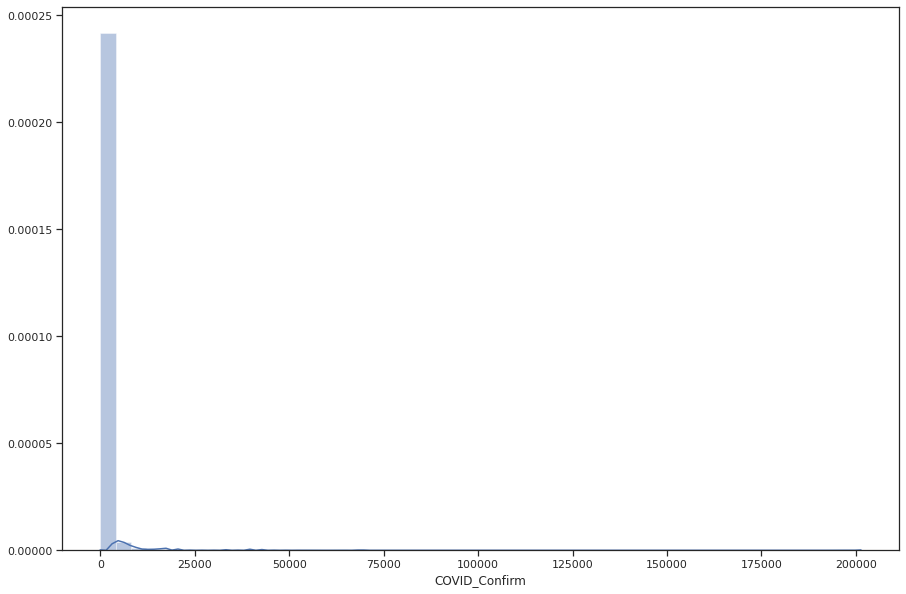

In [ ]:
plt.figure(figsize=(15,10))
plt.tight_layout()
sns.distplot(COVID_19_522_OVERALL_HEALTH['COVID_Confirm'])


## NORMALIZE 

Next, exploring ways to normalize our data resulted in a bell shaped histogram. The most effective process for normaliziation was to take the log of both the COVID Cases and COVID Deaths. The graph below shows the results of a fairly uniform bell curve.  


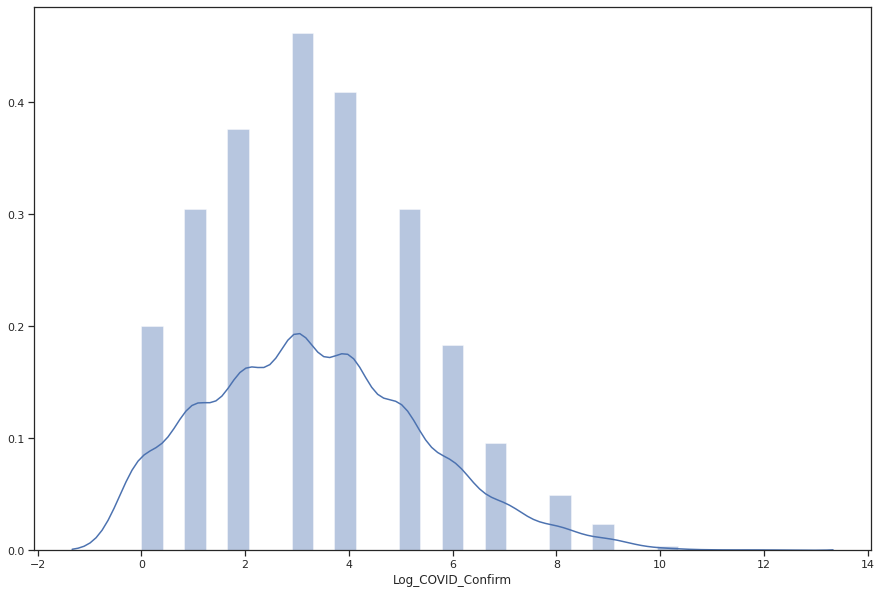

In [ ]:
plt.figure(figsize=(15,10))
plt.tight_layout()
sns.distplot(COVID_19_522_OVERALL_HEALTH['Log_COVID_Confirm'])


# ANSWERING QUESTION #1

## CORRELATION ANALYSIS

What correlations exist between COVID confirmed cases and county health indicators? What correlations exist between COVID deaths and county health indicators?
Again, all 61 county health indicators (from both the overall dataset and the detail dataset) were passed into the correlation analysis. From the 61 indicators, 12 indicators were found to have a correlation greater than 0.2 or less than -0.2 to the Log of Confirmed Cases or Deaths.  The top 14 indicators are reported in the last correlation matrix below.

Five notable correlations include the following:
1. The more sparsely populated the county is, the less COVID confirmed cases. (-0.64)
2. The larger the total population in a county, the more COVID confirmed cases. (0.5)
3. The higher the median income of the White population, the more COVID confirmed cases. (0.47)
4. The higher percentage of Asians in the county, the more COVID confirmed cases.  (0.45)
5. The larger the percentage of people over 65 years in a county, the less COVID confirmed cases. (-0.42)


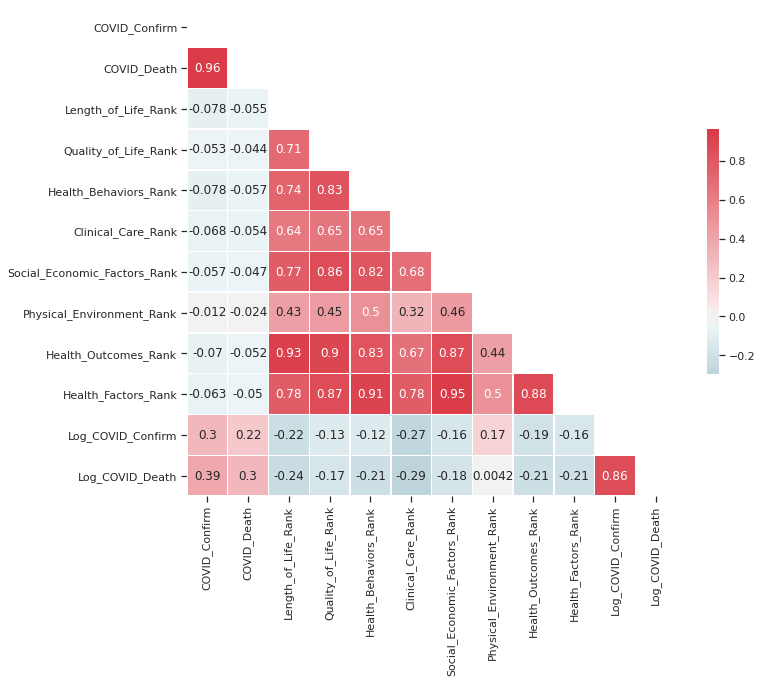

In [ ]:
corr = COVID_19_522_OVERALL_HEALTH.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plt.show()

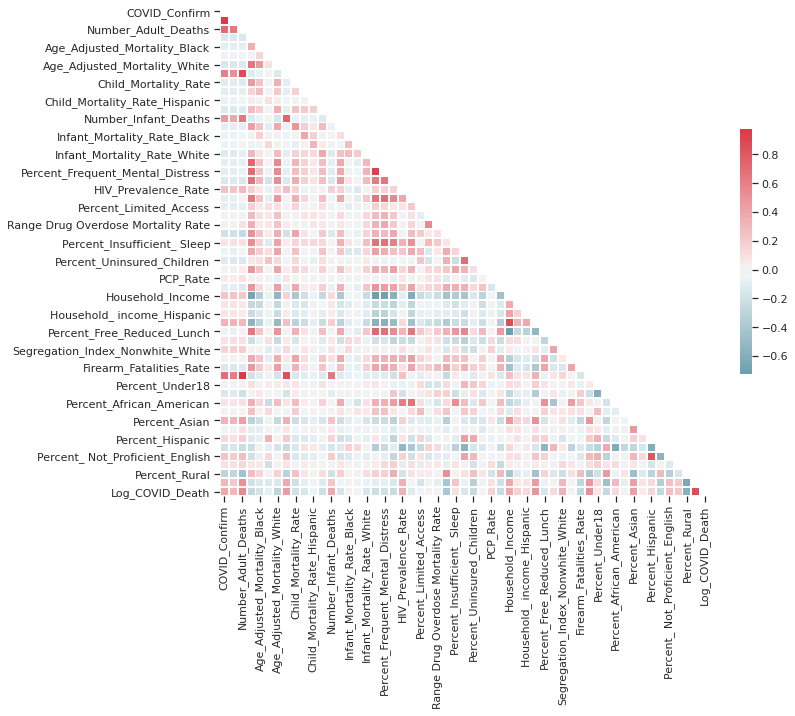

In [ ]:

corr = COVID_19_522_DETAIL_HEALTH.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.9, cbar_kws={"shrink": .5})
plt.show()


In [ ]:
#dfcorr = DataFrame(corr).to_csv(DataDirectory + "DetailCorr.csv")

In [ ]:
#print(corr["Log_COVID_Confirm"].sort_values(ascending=False))


In [ ]:
#print(corr["Log_COVID_Death"].sort_values(ascending=False))

In [ ]:
COVID_19_522_HEALTH_CORRELATION = pandasql.sqldf("SELECT c.State_Name, c.County_Name,c.COVID_Confirm, c.COVID_Death, c.Log_COVID_Death, c.Log_COVID_Confirm,  c.Percent_Rural,c.Percent_65_and_over,c.Percent_Disconnected_Youth,c.Percent_White,c.Percent_Uninsured_Children, c.Segregation_Index_Nonwhite_White, c.HIV_Prevalence_Rate, c.Household_Income, c.Percent_Asian,c.Population, c.[Household_ income_White] Household_income_White, p.DensitySQMile FROM COVID_19_522_DETAIL_HEALTH c LEFT JOIN MetropolitanPopulation p WHERE c.State_Name = p.State_Name AND c.County_Name = p.County_Name")

In [ ]:
COVID_19_522_DETAIL_HEALTH.head()

,State,State_Name,County_Name,COVID_Confirm,COVID_Death,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural,Log_COVID_Confirm,Log_COVID_Death
0,AL,Alabama,Autauga,149,3,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13.0,13.0,12.0,226.0,14.0,12.0,10.0,5.0,20.0,36.0,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416.0,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0,5.0,1.1
1,AL,Alabama,Baldwin,271,9,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13.0,13.0,11.0,164.0,13.0,5.0,18.0,10.0,15.0,33.0,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563.0,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3,5.6,2.2
2,AL,Alabama,Barbour,104,1,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16.0,15.0,18.0,436.0,23.0,11.0,18.0,4.0,19.0,39.0,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965.0,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8,4.6,0.0
3,AL,Alabama,Bibb,55,1,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13.0,13.0,15.0,192.0,16.0,3.0,22.0,8.0,27.0,38.0,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643.0,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4,4.0,0.0
4,AL,Alabama,Blount,49,1,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14.0,14.0,14.0,95.0,11.0,3.0,21.0,8.0,23.0,36.0,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704.0,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0,3.9,0.0


In [ ]:
COVID_19_522_HEALTH_CORRELATION = COVID_19_522_HEALTH_CORRELATION.replace([np.inf, -np.inf], 0)

In [ ]:
COVID_19_522_HEALTH_CORRELATION.Log_COVID_Death.unique()

array([1.1, 2.2, 0. , 2.4, 3.1, 0.7, 1.4, 1.9, 2.3, 1.6, 4.5, 3.5, 1.8,
       4.7, 3.4, 2.9, 4.1, 4.2, 5.9, 4. , 5.2, 3.6, 2.1, 3.3, 7.6, 2.6,
       4.8, 5.7, 5.6, 3.7, 4.3, 4.9, 3. , 3.2, 3.8, 5. , 2.5, 7.1, 6.8,
       6. , 2.7, 6.4, 3.9, 2.8, 4.6, 5.3, 8.1, 5.8, 5.5, 6.3, 5.4, 6.2,
       6.7, 7.3, 6.6, 6.5, 6.9, 7.8, 7.4, 7. , 6.1, 7.9, 7.5, 5.1, 4.4])

In [ ]:
COVID_19_522_HEALTH_CORRELATION['Log_COVID_Confirm'] = COVID_19_522_HEALTH_CORRELATION['Log_COVID_Confirm'].fillna(0)

In [ ]:
COVID_19_522_HEALTH_CORRELATION.isna().sum()

State_Name                           0
County_Name                          0
COVID_Confirm                        0
COVID_Death                          0
Log_COVID_Death                      0
Log_COVID_Confirm                    0
Percent_Rural                       53
Percent_65_and_over                 53
Percent_Disconnected_Youth          53
Percent_White                       53
Percent_Uninsured_Children          53
Segregation_Index_Nonwhite_White    53
HIV_Prevalence_Rate                 53
Household_Income                    53
Percent_Asian                       53
Population                          53
Household_income_White              53
DensitySQMile                        0
dtype: int64

In [ ]:
#COVID_19_522_HEALTH_CORRELATION.dropna(inplace=True)
COVID_19_522_HEALTH_CORRELATION= COVID_19_522_HEALTH_CORRELATION.fillna(0)

In [ ]:
COVID_19_522_HEALTH_CORRELATION.shape

(2862, 18)

In [ ]:
COVID_19_522_HEALTH_CORRELATION.head()

,State_Name,County_Name,COVID_Confirm,COVID_Death,Log_COVID_Death,Log_COVID_Confirm,Percent_Rural,Percent_65_and_over,Percent_Disconnected_Youth,Percent_White,Percent_Uninsured_Children,Segregation_Index_Nonwhite_White,HIV_Prevalence_Rate,Household_Income,Percent_Asian,Population,Household_income_White,DensitySQMile
0,Alabama,Autauga,149,3,1.1,5.0,42.0,14.7,15.0,75.0,3.0,24.0,226.0,54487.0,1.1,55416.0,58556.0,91.8
1,Alabama,Baldwin,271,9,2.2,5.6,42.3,19.7,15.0,83.2,3.0,31.0,164.0,56460.0,1.1,208563.0,54184.0,114.6
2,Alabama,Barbour,104,1,0.0,4.6,67.8,18.0,31.0,46.5,4.0,22.0,436.0,32884.0,0.5,25965.0,46673.0,31.0
3,Alabama,Bibb,55,1,0.0,4.0,68.4,15.4,25.0,74.4,3.0,42.0,192.0,43079.0,0.2,22643.0,42020.0,36.8
4,Alabama,Blount,49,1,0.0,3.9,90.0,18.0,15.0,87.5,4.0,24.0,95.0,47213.0,0.3,57704.0,48045.0,88.9


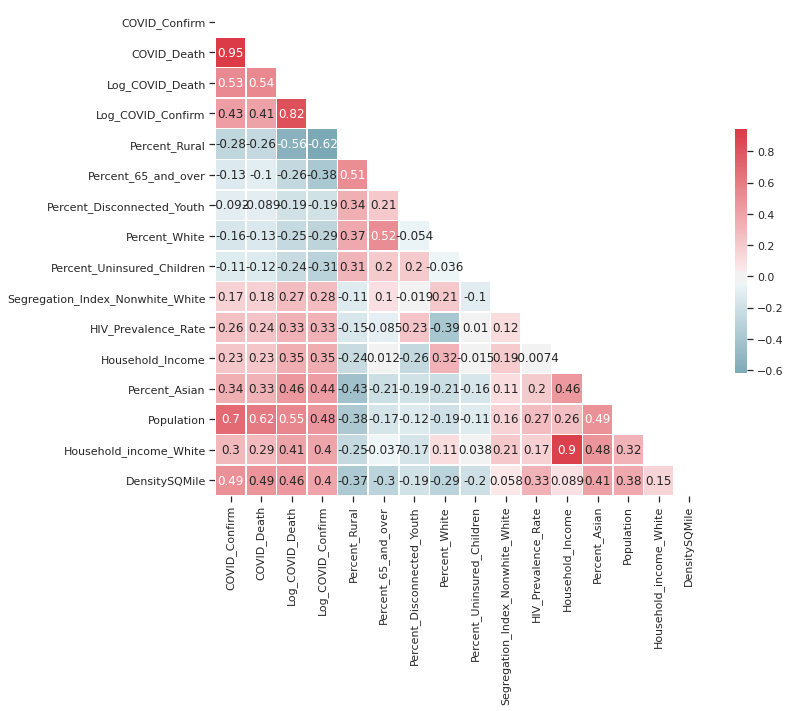

In [ ]:
corr = COVID_19_522_HEALTH_CORRELATION.corr()

#Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

#plt.savefig("plot/COVID_19_522_HEALTH_CORRELATION.png", bbox_inches = 'tight', dpi=400)
plt.show()

In [ ]:
# Create correlation matrix
corr_matrix = COVID_19_522_HEALTH_CORRELATION.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.3)]

In [ ]:
COVID_19_522_HEALTH_CORRELATION.drop(COVID_19_522_HEALTH_CORRELATION[to_drop], axis=1)

,State_Name,County_Name,COVID_Confirm,Segregation_Index_Nonwhite_White
0,Alabama,Autauga,149,24.0
1,Alabama,Baldwin,271,31.0
2,Alabama,Barbour,104,22.0
3,Alabama,Bibb,55,42.0
4,Alabama,Blount,49,24.0
...,...,...,...,...
2857,Wyoming,Sublette,3,30.0
2858,Wyoming,Sweetwater,25,29.0
2859,Wyoming,Teton,100,27.0
2860,Wyoming,Uinta,13,16.0


In [ ]:
list(COVID_19_522_HEALTH_CORRELATION)

['State_Name',
 'County_Name',
 'COVID_Confirm',
 'COVID_Death',
 'Log_COVID_Death',
 'Log_COVID_Confirm',
 'Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Household_Income',
 'Percent_Asian',
 'Population',
 'Household_income_White',
 'DensitySQMile']

In [ ]:
# Creating train and test dataset
train, test = train_test_split(COVID_19_522_HEALTH_CORRELATION, test_size = .30)

In [ ]:
y_train_confirm_column = ['Log_COVID_Confirm']
x_train_confirm_column = ['Percent_Rural',
 'Percent_Disconnected_Youth',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_White',
 'Percent_Asian',
 'Household_income_White']

In [ ]:
y_train_death_column = ['Log_COVID_Death']
x_train_death_column = ['Percent_Rural',
 'Percent_65_and_over',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']

In [ ]:
# Setting up train and test data
# Setting up train and test data
y_train_confirm = DataFrame(train[y_train_confirm_column])
x_train_confirm = DataFrame(train[x_train_confirm_column])
y_test_confirm = DataFrame(test[y_train_confirm_column])
x_test_confirm = DataFrame(test[x_train_confirm_column])

In [ ]:
# Setting up train and test data
y_train_death = DataFrame(train[y_train_death_column])
x_train_death = DataFrame(train[x_train_death_column])
y_test_death = DataFrame(test[y_train_death_column])
x_test_death = DataFrame(test[x_train_death_column])

In [ ]:
x_test_death.head()

,Percent_Rural,Percent_65_and_over,Percent_White,Percent_Uninsured_Children,Segregation_Index_Nonwhite_White,HIV_Prevalence_Rate,Percent_Asian,Household_income_White
327,5.0,31.7,76.0,9.0,45.0,277.0,1.5,49337.0
0,42.0,14.7,75.0,3.0,24.0,226.0,1.1,58556.0
1196,26.9,13.5,88.6,3.0,32.0,43.0,2.3,53573.0
1516,100.0,25.3,96.0,8.0,31.0,49.0,0.2,42685.0
616,13.3,16.3,85.3,2.0,46.0,91.0,1.0,57848.0


# ANSWERING QUESTION #2
Which indicators are significant in modeling COVID cases and deaths?

All 12 indicators were passed through an OLS Regression model. Eight health indicators were discovered that are statistically significant predictors for the number of COVID cases in a county.  All indicators with P-values larger than 0.05 were removed, which narrowed the list of 12 down to 8 significant health indicators.  The R-squared is 0.865 with a large F-statistic of 1601 which is considerably greater than 1 which points to the 8 indicators being significant. In addition, the High Density Interval of each of the 8 indicators does not overlap with zero, again supporting that that the indicators are each credible.


##MODELS

### OLS 

In [ ]:
ols_model_fit_confirm = sm.OLS(y_train_confirm, x_train_confirm).fit()
ols_model_fit_confirm.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:      Log_COVID_Confirm   R-squared (uncentered):                   0.867
Model:                            OLS   Adj. R-squared (uncentered):              0.866
Method:                 Least Squares   F-statistic:                              1621.
Date:                Mon, 15 Jun 2020   Prob (F-statistic):                        0.00
Time:                        21:45:21   Log-Likelihood:                         -3733.2
No. Observations:                2003   AIC:                                      7482.
Df Residuals:                    1995   BIC:                                      7527.
Df Model:                           8                                                  
Covariance Type:            nonrobust                                                  
====================================================================================================
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Percent_Rural                       -0.0243      0.002    -16.060      0.000      -0.027      -0.021
Percent_Disconnected_Youth           0.0213      0.004      4.935      0.000       0.013       0.030
Percent_Uninsured_Children          -0.0531      0.012     -4.614      0.000      -0.076      -0.031
Segregation_Index_Nonwhite_White     0.0381      0.003     13.723      0.000       0.033       0.044
HIV_Prevalence_Rate                  0.0027      0.000     11.115      0.000       0.002       0.003
Percent_White                        0.0056      0.002      2.897      0.004       0.002       0.009
Percent_Asian                        0.0325      0.015      2.128      0.033       0.003       0.063
Household_income_White            5.627e-05   2.73e-06     20.631      0.000    5.09e-05    6.16e-05
==============================================================================
Omnibus:                       80.439   Durbin-Watson:                   1.899
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              230.440
Skew:                           0.103   Prob(JB):                     9.13e-51
Kurtosis:                       4.649   Cond. No.                     2.35e+04
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.35e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Text(0.5, 0.98, 'Actual vs predicted confirm')

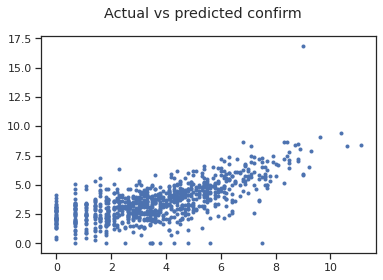

In [ ]:
# Testing the confirm model
ols_model_pred_confirm = ols_model_fit_confirm.predict(x_test_confirm)
plt.plot(y_test_confirm, ols_model_pred_confirm, '.')
plt.suptitle('Actual vs predicted confirm')

In [ ]:
ols_model_fit_death = sm.OLS(y_train_death, x_train_death).fit()
ols_model_fit_death.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:        Log_COVID_Death   R-squared (uncentered):                   0.633
Model:                            OLS   Adj. R-squared (uncentered):              0.632
Method:                 Least Squares   F-statistic:                              430.1
Date:                Mon, 15 Jun 2020   Prob (F-statistic):                        0.00
Time:                        21:45:21   Log-Likelihood:                         -3069.5
No. Observations:                2003   AIC:                                      6155.
Df Residuals:                    1995   BIC:                                      6200.
Df Model:                           8                                                  
Covariance Type:            nonrobust                                                  
====================================================================================================
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
Percent_Rural                       -0.0165      0.001    -14.723      0.000      -0.019      -0.014
Percent_65_and_over                  0.0054      0.007      0.812      0.417      -0.008       0.018
Percent_White                       -0.0051      0.002     -3.121      0.002      -0.008      -0.002
Percent_Uninsured_Children          -0.0455      0.008     -5.497      0.000      -0.062      -0.029
Segregation_Index_Nonwhite_White     0.0227      0.002     11.385      0.000       0.019       0.027
HIV_Prevalence_Rate                  0.0017      0.000      9.994      0.000       0.001       0.002
Percent_Asian                        0.0510      0.011      4.637      0.000       0.029       0.073
Household_income_White            2.821e-05   1.96e-06     14.389      0.000    2.44e-05    3.21e-05
==============================================================================
Omnibus:                      126.158   Durbin-Watson:                   1.991
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              161.147
Skew:                           0.583   Prob(JB):                     1.02e-35
Kurtosis:                       3.755   Cond. No.                     2.37e+04
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.37e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Text(0.5, 0.98, 'Actual vs predicted death rate')

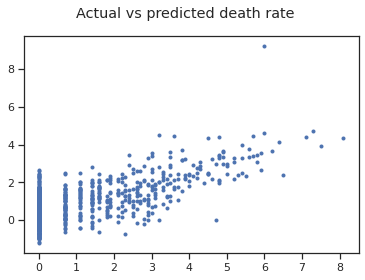

In [ ]:
# Testing the death model
ols_model_pred_death = ols_model_fit_death.predict(x_test_death)
plt.plot(y_test_death, ols_model_pred_death, '.')
plt.suptitle('Actual vs predicted death rate')

### LINEAR REGRESSION

In [ ]:
# CONFIRM 

# Setting up variable for linear regression
reg_model = linear_model.LinearRegression()

# Train and test the modele
reg_model.fit(x_train_confirm, y_train_confirm)
y_pred_confirm = reg_model.predict(x_test_confirm)

In [ ]:
#Model summary confirm 
print('coefficients: {}\nintercept: {}\nmean squared error: {}\nR-squared: {}'.format(
    reg_model.coef_,
    reg_model.intercept_,
    mean_squared_error(y_test_confirm, y_pred_confirm),
    r2_score(y_test_confirm, y_pred_confirm)
))

coefficients: [[-2.61975946e-02 -3.27526464e-03 -1.04116510e-01  2.97130549e-02
   1.89435115e-03 -1.30931887e-02  1.95363567e-02  3.37605669e-05]]
intercept: [3.93501253]
mean squared error: 1.938010478098714
R-squared: 0.560028188057927


Text(0.5, 0.98, 'Actual vs predicted confirm')

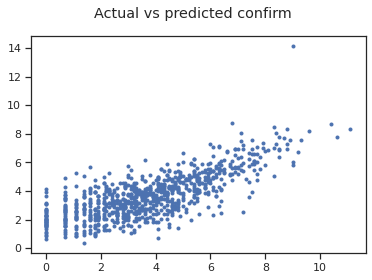

In [ ]:
# Plotting actual and predicted values
plt.plot(y_test_confirm, y_pred_confirm, '.')
plt.suptitle('Actual vs predicted confirm')

In [ ]:
# DEATH 

# Setting up variable for linear regression
reg_model = linear_model.LinearRegression()

# Train and test the modele
reg_model.fit(x_train_death, y_train_death)
y_pred_death = reg_model.predict(x_test_death)

In [ ]:
#Model summary confirm 
print('coefficients: {}\nintercept: {}\nmean squared error: {}\nR-squared: {}'.format(
    reg_model.coef_,
    reg_model.intercept_,
    mean_squared_error(y_test_death, y_pred_death),
    r2_score(y_test_death, y_pred_death)
))

coefficients: [[-1.67079113e-02 -2.97927097e-03 -7.34801795e-03 -5.43499318e-02
   2.11863991e-02  1.51194709e-03  5.03393975e-02  2.44883807e-05]]
intercept: [0.6750761]
mean squared error: 1.2852507414349899
R-squared: 0.4764803064816956


Text(0.5, 0.98, 'Actual vs predicted death')

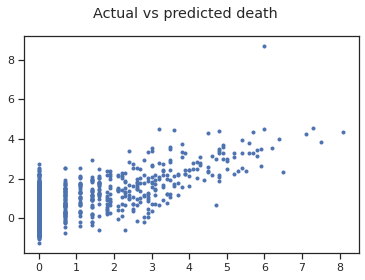

In [ ]:
# Plotting actual and predicted values
plt.plot(y_test_death, y_pred_death, '.')
plt.suptitle('Actual vs predicted death')

# ANSWERING QUESTION #3

Can clustering of the most significant factors be used to create risk indicators for counties?



##CLUSTER
Further data exploration was conducted using principal component analysis (PCA) technique to aid in clustering the data in order to assign risk index numbers to the counties. PCA reduces the dimensionality of a multivariable dataset while retaining its variations. This allows for the analysis of clusters present in this high dimensional dataset on two-dimensional graph. The X and Y axes are two artificial dimensions create by the PCA. Again, the axes try to express as much of the original information of each of the 10 variables (8 predictors plus COVID confirmed and COVID deaths). In the graph, each county is represented by each circle and the color indicates the cluster ID. Each line represents a variable and provides  the relative distance of a county to that particular variable. 

In [ ]:
cluster_confirm= COVID_19_522_HEALTH_CORRELATION[['State_Name',
 'County_Name','Log_COVID_Confirm','Log_COVID_Death','Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']]

In [ ]:
DataFrame(cluster_confirm)

,State_Name,County_Name,Log_COVID_Confirm,Log_COVID_Death,Percent_Rural,Percent_65_and_over,Percent_Disconnected_Youth,Percent_White,Percent_Uninsured_Children,Segregation_Index_Nonwhite_White,HIV_Prevalence_Rate,Percent_Asian,Household_income_White
0,Alabama,Autauga,5.0,1.1,42.0,14.7,15.0,75.0,3.0,24.0,226.0,1.1,58556.0
1,Alabama,Baldwin,5.6,2.2,42.3,19.7,15.0,83.2,3.0,31.0,164.0,1.1,54184.0
2,Alabama,Barbour,4.6,0.0,67.8,18.0,31.0,46.5,4.0,22.0,436.0,0.5,46673.0
3,Alabama,Bibb,4.0,0.0,68.4,15.4,25.0,74.4,3.0,42.0,192.0,0.2,42020.0
4,Alabama,Blount,3.9,0.0,90.0,18.0,15.0,87.5,4.0,24.0,95.0,0.3,48045.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2857,Wyoming,Sublette,1.1,0.0,100.0,14.5,14.0,88.1,10.0,30.0,32.0,1.1,75112.0
2858,Wyoming,Sweetwater,3.2,0.0,10.9,10.5,10.0,79.6,7.0,29.0,87.0,0.8,70793.0
2859,Wyoming,Teton,4.6,0.0,46.4,13.5,10.0,81.5,12.0,27.0,51.0,1.2,81423.0
2860,Wyoming,Uinta,2.6,0.0,43.1,12.6,10.0,87.5,7.0,16.0,51.0,0.6,81423.0


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.preprocessing import StandardScaler
from sklearn import decomposition

%matplotlib inline
np.random.seed(0)


In [ ]:
cluster_confirm= COVID_19_522_HEALTH_CORRELATION[['Log_COVID_Confirm','Log_COVID_Death','Percent_Rural','State_Name','County_Name','Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']]

In [ ]:
from sklearn.cluster import KMeans


sse = []
k_rng = range(1,15)
for k in k_rng:
    km = KMeans(n_clusters=k)
    km.fit(cluster_confirm[['Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']])
    sse.append(km.inertia_)

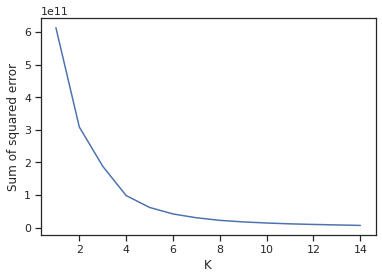

In [ ]:
plt.xlabel('K')
plt.ylabel('Sum of squared error')
plt.plot(k_rng,sse)

In [ ]:
km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(cluster_confirm[['Percent_Rural',
 'Percent_65_and_over',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']])
y_predicted

array([2, 2, 0, ..., 1, 1, 2], dtype=int32)

In [ ]:
cluster_confirm['cluster']=y_predicted
cluster_confirm.head()

,Log_COVID_Confirm,Log_COVID_Death,Percent_Rural,State_Name,County_Name,Percent_65_and_over,Percent_Disconnected_Youth,Percent_White,Percent_Uninsured_Children,Segregation_Index_Nonwhite_White,HIV_Prevalence_Rate,Percent_Asian,Household_income_White,cluster
0,5.0,1.1,42.0,Alabama,Autauga,14.7,15.0,75.0,3.0,24.0,226.0,1.1,58556.0,2
1,5.6,2.2,42.3,Alabama,Baldwin,19.7,15.0,83.2,3.0,31.0,164.0,1.1,54184.0,2
2,4.6,0.0,67.8,Alabama,Barbour,18.0,31.0,46.5,4.0,22.0,436.0,0.5,46673.0,0
3,4.0,0.0,68.4,Alabama,Bibb,15.4,25.0,74.4,3.0,42.0,192.0,0.2,42020.0,0
4,3.9,0.0,90.0,Alabama,Blount,18.0,15.0,87.5,4.0,24.0,95.0,0.3,48045.0,2


The biplot results below illustrates the three clusters obtained relative to the health indicators in the counties. The colors in the plot shows the different clusters present while the circles represent the counties. For example, the red circle next to Percent_Disconnected_Youth indicates a county belonging to a particular cluster ID and its closeness to the variable/measure means that it has a high supporting rate for that measure. The closer the county and cluster are to the measure/variable, the higher the supporting rate.

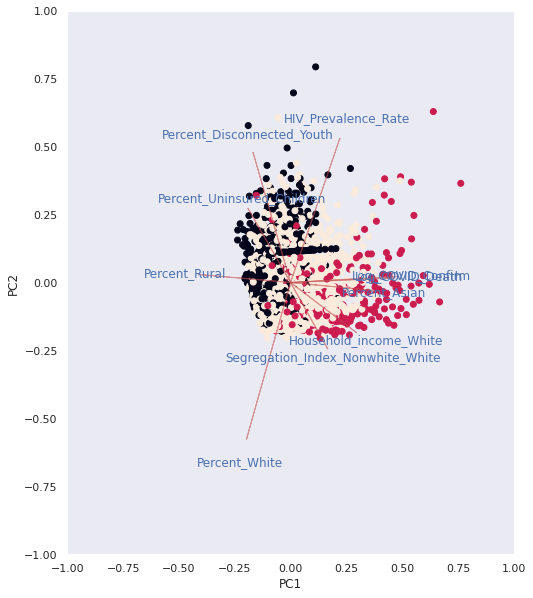

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.decomposition import PCA
import pandas as pd
from sklearn.preprocessing import StandardScaler

sns.set(rc={'figure.figsize':(8,10)})

clusterconf = cluster_confirm
X = clusterconf[['Log_COVID_Confirm','Log_COVID_Death','Percent_Rural',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']]
y = clusterconf.cluster

label=['Log_COVID_Confirm','Log_COVID_Death','Percent_Rural',
 'Percent_Disconnected_Youth',
 'Percent_White',
 'Percent_Uninsured_Children',
 'Segregation_Index_Nonwhite_White',
 'HIV_Prevalence_Rate',
 'Percent_Asian',
 'Household_income_White']

#Scale the data prior to PCA.
scaler = StandardScaler()
scaler.fit(X)
X=scaler.transform(X)    
pca = PCA()
x_new = pca.fit_transform(X)

def myplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1/(xs.max() - xs.min())
    scaley = 1/(ys.max() - ys.min())
    plt.scatter(xs * scalex,ys * scaley, c = y, )
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, label[i], color = 'b', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, label[i], color = 'b', ha = 'center', va = 'center')

    plt.xlim(-1,1)
    plt.ylim(-1,1)
    plt.xlabel("PC{}".format(1))
    plt.ylabel("PC{}".format(2))
    plt.grid()
  
#Call the function. Use only the 2 PCs.
myplot(x_new[:,:],np.transpose(pca.components_[0:2, :]))

xv=myplot

plt.show()

In [ ]:
km.cluster_centers_


array([[6.59019934e+01, 1.88404485e+01, 2.06245847e+01, 7.56485050e+01,
        6.13039867e+00, 2.80880399e+01, 1.50972591e+02, 6.77574751e-01,
        3.97651121e+04],
       [2.74418605e+01, 1.46391473e+01, 1.24031008e+01, 6.96387597e+01,
        5.13953488e+00, 3.28604651e+01, 2.30317829e+02, 5.14108527e+00,
        8.20222636e+04],
       [5.34240714e+01, 1.78504286e+01, 1.60428571e+01, 7.69691429e+01,
        6.38642857e+00, 3.16292857e+01, 1.59016429e+02, 1.40114286e+00,
        5.52030979e+04]])

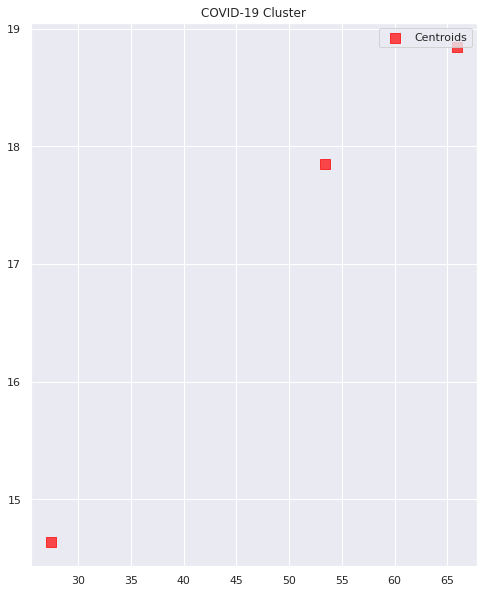

In [ ]:
plt.scatter(km.cluster_centers_[:,0],km.cluster_centers_[:,1],s=100,marker='s', c='red', alpha=0.7, label='Centroids')
plt.legend()
plt.title('COVID-19 Cluster')
plt.xlabel('')
plt.ylabel('')
plt.legend()
plt.show()

In [ ]:
states_by_county_death.head()

,Date_as_of,First_week,Last_week,State,County_Name,FIPS_County_Code,Deaths_involving_COVID-19,Deaths_from_All_Causes
0,5/20/2020,2/1/2020,5/16/2020,AL,Etowah,01055,11,432
1,5/20/2020,2/1/2020,5/16/2020,AL,Houston,01069,24,542
2,5/20/2020,2/1/2020,5/16/2020,AL,Jefferson,01073,79,2675
3,5/20/2020,2/1/2020,5/16/2020,AL,Lee,01081,43,362
4,5/20/2020,2/1/2020,5/16/2020,AL,Madison,01089,10,1149


In [ ]:
detail_2018_county_health_rankings.head()

,FIPS,State_Name,County,Number_Adult_Deaths,Age_Adjusted_Mortality,Age_Adjusted_Mortality_Black,Age_Adjusted_Mortality_Hispanic,Age_Adjusted_Mortality_White,Number_Child_Deaths,Child_Mortality_Rate,Child_Mortality_Rate_Black,Child_Mortality_Rate_Hispanic,Child_Mortality_Rate_White,Number_Infant_Deaths,Infant Mortality Rate,Infant_Mortality_Rate_Black,Infant_Mortality_Rate_Hispanic,Infant_Mortality_Rate_White,Percent_Frequent_Physical_Distress,Percent_Frequent_Mental_Distress,Percent_Diabetic,HIV_Prevalence_Rate,Percent_Food_Insecure,Percent_Limited_Access,Drug_Overdose_Mortality_Rate,Range Drug Overdose Mortality Rate,Motor_Vehicle_Mortality_Rate,Percent_Insufficient_ Sleep,Percent_Uninsured_Adults,Percent_Uninsured_Children,Heath_Care_Costs,PCP_Rate,Percent_Disconnected_Youth,Household_Income,Household_ income_Black,Household_ income_Hispanic,Household_ income_White,Percent_Free_Reduced_Lunch,Segregation_Index_Black_White,Segregation_Index_Nonwhite_White,Homicide_Rate,Firearm_Fatalities_Rate,Population,Percent_Under18,Percent_65_and_over,Percent_African_American,Percent_American_Alaskan_Indian,Percent_Asian,Percent_Hawaiian_PacificIslander,Percent_Hispanic,Percent_White,Percent_ Not_Proficient_English,Percent_Female,Percent_Rural
0,1001,Alabama,Autauga,827.0,450.0,532.0,111.0,445.0,31.0,56.2,87.0,77.5,44.5,34.0,8.0,11.0,5.0,5.0,13,13,12,226.0,14,12.0,10.0,5.0,20.0,36,12.0,3.0,10674.0,29.0,15.0,54487.0,32173.0,72411.0,58556.0,48.0,26.0,24.0,4.0,17.0,55416,24.4,14.7,19.0,0.5,1.1,0.1,2.7,75.0,0.8,51.3,42.0
1,1003,Alabama,Baldwin,2753.0,351.0,518.0,111.0,349.0,85.0,47.7,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,13,13,11,164.0,13,5.0,18.0,10.0,15.0,33,15.0,3.0,9537.0,44.0,15.0,56460.0,26818.0,41908.0,54184.0,46.0,44.0,31.0,3.0,15.0,208563,21.7,19.7,9.0,0.8,1.1,0.1,4.4,83.2,0.8,51.5,42.3
2,1005,Alabama,Barbour,418.0,434.0,477.0,111.0,395.0,15.0,66.6,87.0,77.5,44.5,85.0,6.0,11.0,5.0,5.0,16,15,18,436.0,23,11.0,18.0,4.0,19.0,39,17.0,4.0,9791.0,27.0,31.0,32884.0,21546.0,25850.0,46673.0,66.0,26.0,22.0,9.0,14.0,25965,21.1,18.0,47.5,0.6,0.5,0.2,4.2,46.5,1.5,46.9,67.8
3,1007,Alabama,Bibb,408.0,529.0,630.0,111.0,527.0,22.0,116.3,87.0,77.5,44.5,25.0,15.0,11.0,5.0,5.0,13,13,15,192.0,16,3.0,22.0,8.0,27.0,38,15.0,3.0,10756.0,75.0,25.0,43079.0,28256.0,45909.0,42020.0,61.0,43.0,42.0,8.0,21.0,22643,20.8,15.4,21.6,0.4,0.2,0.1,2.5,74.4,0.4,46.4,68.4
4,1009,Alabama,Blount,996.0,480.0,630.0,111.0,527.0,30.0,55.4,87.0,77.5,44.5,25.0,5.0,11.0,5.0,5.0,14,14,14,95.0,11,3.0,21.0,8.0,23.0,36,18.0,4.0,10326.0,12.0,15.0,47213.0,37647.0,34375.0,48045.0,55.0,40.0,24.0,6.0,19.0,57704,23.2,18.0,1.4,0.6,0.3,0.1,9.1,87.5,1.9,50.6,90.0


###CLUSTER MAP
The three clusterID's obtained in the initial cluster analysis were used to assign risk index numbers to the counties. The results where plotted on a US map where blue represents counties with higher risk, such as counties in NY, NJ and CA, yellow represents counties with medium risk, and purple represent counties with low risk.


In [ ]:
show_plotly_in_colab()
init_notebook_mode(connected=False)

state_county_map2['FIPS'] = state_county_map2.FIPS 

colorscale=['#2831c0','#b728c0','#c0b728','#28c0b7','#c0287d']


endpts = list(np.linspace(1, 5, len(colorscale) - 5))
fips = state_county_map2['FIPS'].tolist()
values = state_county_map2['Clusters'].tolist()

fig = ff.create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=True,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='COVID-19 Cluster ',
    legend_title='Cluster'
)

fig.layout.template = None
fig.show()

/usr/local/lib/python3.6/dist-packages/plotly/figure_factory/_county_choropleth.py:845: UserWarning:

Unrecognized FIPS Values

Whoops! It looks like you are trying to pass at least one FIPS value that is not in our shapefile of FIPS and data for the counties. Your choropleth will still show up but these counties cannot be shown.
Unrecognized FIPS are: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]



#CONCLUSION
How might counties be assigned risk index numbers to help prioritize and allocate resources?
<P>
The coronovirus epidermic has widened the existing social, geographic and economic challenges in communities across the country. While the county health rankings do not measure coronavirus cases nor rank the risk of the virus spreading in communities, the county health ranking data are helpful in providing local context and the factors that impact health. In fact, twelve of these indicators can be correlated to COVID cases and eight of these indicators can be used to model COVID cases in a county.  
<p>
Once these significant indicators were discovered, the Risk index numbers assigned to counties in this analysis can be used during epidemics by the government in allocating resources to states. Counties and local authorities can use the risk index to outline preventive measures or guidelines and provide training or educational resources in handling these types of health emergencies in the future. For example, data collected and analyzed by New York City during hurricane Sandy has helped the city recreate hurricane evacuation zones ranked by risk of storm surge impact. The city changed the outdated hurricane evacuation zones from the A,B,C format to a numeric format ranging from 1-6 based on the storm's impact in areas around the city. The data was also used to create an Incident Command System (ICS) that provided periodic trainings to non-emergency city workers about the roles expected of them when the ICS is activated. Staff are assigned roles based on their and closeness to evacuation zones in order to cut travel time and provide the necessary expertise needed during emergencies.
<p>
In addtion, it is important to emphasize that while many of these health indicators have shown medium to high correlation along with several being statistically significant predictors of COVID confirmed cases, there is no implication in the causation of the number of COVID cases due to these particular indicators. If anything, this analysis shows the need for further exploration of using health indicators as predictions or rankings for health epidemics across our nation.  